# Bi-Variate Regression Analysis
This notebook takes a look at the comprehensive set of variables that might have some relation to sleep outcomes for the bpeace1 study. We only consider one explanatory and one outcome variable. 

In [14]:
import pandas as pd
import numpy as np

## Data Import
Data are imported from the processed files for the beacon, Beiwe system, and Fitbit.

### Beacon
Starting with the data collected over Python 3 (nicknamed adafruit since most of the sensors are from that company)

In [15]:
df_py3 = pd.read_csv('/Users/hagenfritz/Projects/utx000/studies/cohort1/processed_data/study_adafruit_sleepstats',parse_dates=True,index_col=0)
df_py3['inc%'] = (df_py3['max'] - df_py3['min'])/df_py3['min']

In [16]:
df_py3.head()

,ID,var,mean,median,max,min,std,inc%
sleep_day,,,,,,,,
2020-01-23,332b3bxa,eCO2,400.0,400.0,400.0,400.0,0.0,0.0
2020-02-01,332b3bxa,eCO2,400.0,400.0,400.0,400.0,0.0,0.0
2020-02-12,332b3bxa,eCO2,400.0,400.0,400.0,400.0,0.0,0.0
2020-02-22,332b3bxa,eCO2,400.0,400.0,400.0,400.0,0.0,0.0
2020-03-03,332b3bxa,eCO2,400.0,400.0,400.0,400.0,0.0,0.0


Now importing data from the sensors collected over Python 2 (nicknamed such since only the Sensirion sensors require Python 2).

In [17]:
df_py2 = pd.read_csv('/Users/hagenfritz/Projects/utx000/studies/cohort1/processed_data/study_sensirion_sleepstats',parse_dates=True,index_col=0)
df_py2['inc%'] = (df_py2['max'] - df_py2['min'])/df_py2['min']

In [18]:
df_py2.head()

,ID,var,mean,median,max,min,std,inc%
sleep_day,,,,,,,,
2020-01-23,332b3bxa,Temperature [C],24.028501,24.050697,24.383156,23.662163,0.224960,0.030470
2020-02-01,332b3bxa,Temperature [C],23.219098,23.117416,24.522011,21.990540,0.718377,0.115116
2020-02-12,332b3bxa,Temperature [C],26.743766,26.700996,28.305870,26.196304,0.412137,0.080529
2020-02-22,332b3bxa,Temperature [C],26.952201,26.954681,27.379265,26.490044,0.191550,0.033568
2020-03-03,332b3bxa,Temperature [C],28.708112,28.701073,29.163040,28.220413,0.276476,0.033402


### EMAs
Here we look at only the morning and evening surveys as the weekly surveys are not fine-grained enough. If anything, the daily mood should be reflected in the weekly mood scores.

In [19]:
df_morning = pd.read_csv('/Users/hagenfritz/Projects/utx000/studies/cohort1/processed_data/study_morningEMA.csv',parse_dates=True,index_col=0)

In [20]:
df_morning.head()

,SleepOnsetLatency,TotalHoursAsleep,WakeAfterSleepOnset,Restfulness,Content,Lonely,Sad,Stress,Energy,ID,Submitted
date,,,,,,,,,,,
2020-02-03 16:06:25,15.0,6.5,1.0,2.0,2.0,0.0,0.0,1.0,2.0,6mkypp1o,2020-02-03 16:06:25
2020-03-02 01:01:45,15.0,9.5,4.0,2.0,2.0,0.0,0.0,1.0,3.0,6mkypp1o,2020-03-02 01:01:45
2020-02-28 14:06:27,15.0,6.5,2.0,1.0,1.0,0.0,0.0,1.0,1.0,6mkypp1o,2020-02-28 14:06:27
2020-02-21 13:30:11,15.0,5.5,2.0,1.0,2.0,0.0,0.0,0.0,1.0,6mkypp1o,2020-02-21 13:30:11
2020-02-10 16:25:38,15.0,6.5,1.0,1.0,1.0,0.0,0.0,1.0,2.0,6mkypp1o,2020-02-10 16:25:38


In [21]:
df_evening = pd.read_csv('/Users/hagenfritz/Projects/utx000/studies/cohort1/processed_data/study_eveningEMA.csv',parse_dates=True,index_col=0)

In [22]:
df_evening.head()

,Content,Lonely,Sad,Stress,Energy,ID,Submitted
date,,,,,,,
2020-02-04 17:10:22,2.0,1.0,1.0,2.0,3.0,6mkypp1o,2020-02-04 17:10:22
2020-03-07 18:19:00,1.0,0.0,2.0,2.0,2.0,6mkypp1o,2020-03-07 18:19:00
2020-02-03 16:04:37,2.0,0.0,0.0,1.0,2.0,6mkypp1o,2020-02-03 16:04:37
2020-03-02 01:01:56,2.0,0.0,0.0,1.0,3.0,6mkypp1o,2020-03-02 01:01:56
2020-02-11 01:05:36,2.0,0.0,0.0,1.0,3.0,6mkypp1o,2020-02-11 01:05:36


### Fitbit
The main sleep metrics are measured here in addition to some activity measures like number of steps that *should* have implications for sleep.

#### Sleep Summary
The data represented here are going to be the outcome variables - primarily sleep efficiency and REM:nREM.

In [23]:
df_ss = pd.read_csv('/Users/hagenfritz/Projects/utx000/studies/cohort1/processed_data/study_sleepStagesDay.csv',parse_dates=True,index_col=0)

In [24]:
df_ss.head()

,TotalSleepRecords,TotalMinutesAsleep,TotalTimeInBed,TotalTimeAwake,TotalMinutesLight,TotalMinutesDeep,TotalMinutesREM,Efficiency,Awake%,Light%,Deep%,REM%,Non-REM%,REM/nREM,TotalHoursAsleep,ID
SleepDay,,,,,,,,,,,,,,,,
2020-01-22,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,9l7wmsc3
2020-01-23,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,9l7wmsc3
2020-01-24,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,9l7wmsc3
2020-01-25,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,9l7wmsc3
2020-01-26,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,9l7wmsc3


#### Steps
We used daily steps as perhaps a proxy for activity durign the day.

In [25]:
df_steps = pd.read_csv('/Users/hagenfritz/Projects/utx000/studies/cohort1/processed_data/study_dailySteps.csv',index_col=0,parse_dates=True)

In [26]:
df_steps.head()

,StepTotal,ID
ActivityDay,,
2020-01-22,3499,9l7wmsc3
2020-01-23,6700,9l7wmsc3
2020-01-24,9777,9l7wmsc3
2020-01-25,4291,9l7wmsc3
2020-01-26,4389,9l7wmsc3


## One Variable Regression
Now we step through the various variables to see to what extent they affect our outcome variables. The primary outcome variables that we will look at are:
1. Sleep Efficiency: Percentage of time asleep while in bed
2. REM/nREM: This ratio is more revealing than looking at the individual stages since REM is dependent on the length of sleep.
3. %Awake: If the occupant is uncomfortable then we should see them tossing and turning more i.e. waking more often according to Fitbit.

In [27]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline 

import statsmodels.api as sm

In [28]:
def plotLinearRegression(X,xlim,Y,ylim,show_plot=True):
    '''
    Inputs:
        - X: list of values corresponding to the independent variable
        - xlim: list of two values specifying the lower and upper bounds of the horizontal axis
        - Y: list of values corresponding to the dependent variable
        - ylim: list of two values specifying the lower and upper bounds of the vertical axis
    Plots a linear regression of the two variables and returns the ax handle if successful, otherwise False
    '''
    
    sns.set(style="white", rc={"axes.facecolor": (0, 0, 0, 0)}, font_scale=1)
    
    try:
        if len(X) > 1:
            t = np.arange(len(X))
            X = sm.add_constant(X)
            model = sm.OLS(Y, X).fit()
            predictions = model.predict(X) # make the predictions by the model

            # Plotting
            if show_plot:
                ## Scatter
                fig,ax = plt.subplots(figsize=(10,10))
                ax.scatter(X[:,1],Y,c=t,s=100,cmap='Blues',edgecolor='black')

                ## Line of Best Fit
                ax.plot(X[:,1],predictions,color='red')

                top = 0
                bot = 0
                for i in range(len(predictions)):
                    top += (predictions[i]-np.mean(Y))**2
                    bot += (Y[i] - np.mean(Y))**2
                rsqrd = top/bot

                ## Formatting Remainder of Axis
                ax.set_xlim(xlim)
                ax.set_ylim(ylim)
                ### Print out the statistics
                loc_x = min(xlim)+0.01*(max(xlim)-min(xlim))
                loc_y = min(ylim)+0.01*(max(ylim)-min(ylim))
                ax.text(loc_x,loc_y+0.1*(max(ylim)-min(ylim)),'Intercept: ' + str(round(model.params[0],4)))
                ax.text(loc_x,loc_y+0.05*(max(ylim)-min(ylim)),'Slope: ' + str(round(model.params[1],4)))
                ax.text(loc_x,loc_y,'r$^2$: ' + str(round(rsqrd,4)))
                
                return ax, model
            else:
                return False, model
    except Exception as inst:
        print(inst)

        return False, False

### Outcome Variable: Sleep Efficiency
Here the outcome variable is sleep efficiency and we look at the strength of the various variables to explain sleep efficiency.

#### Python3 Sensors

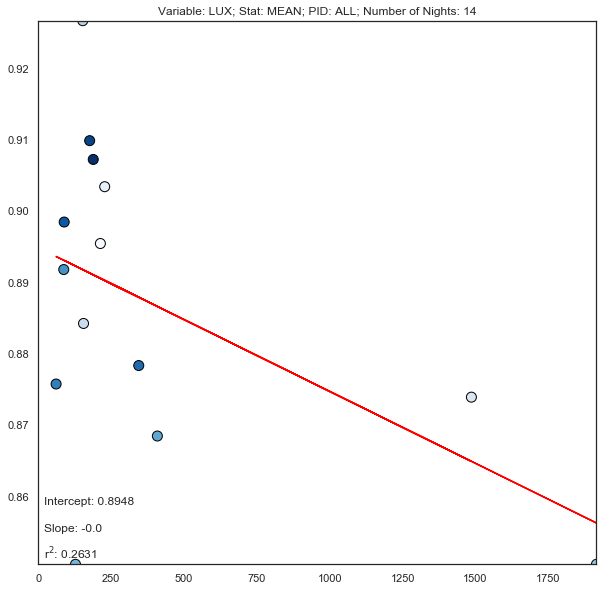

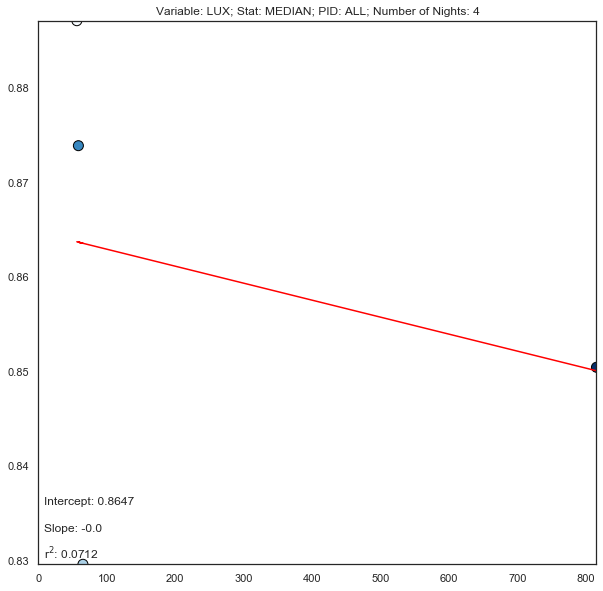

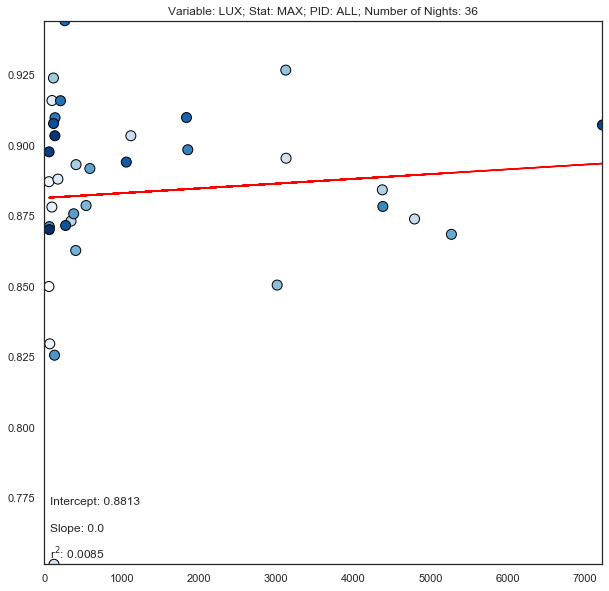

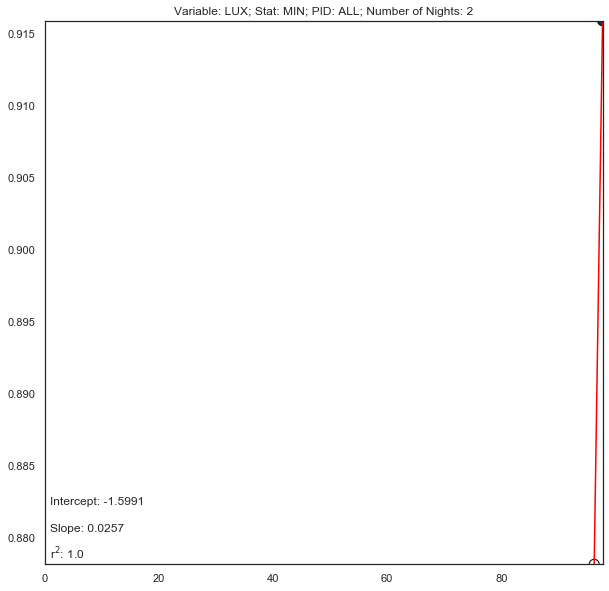

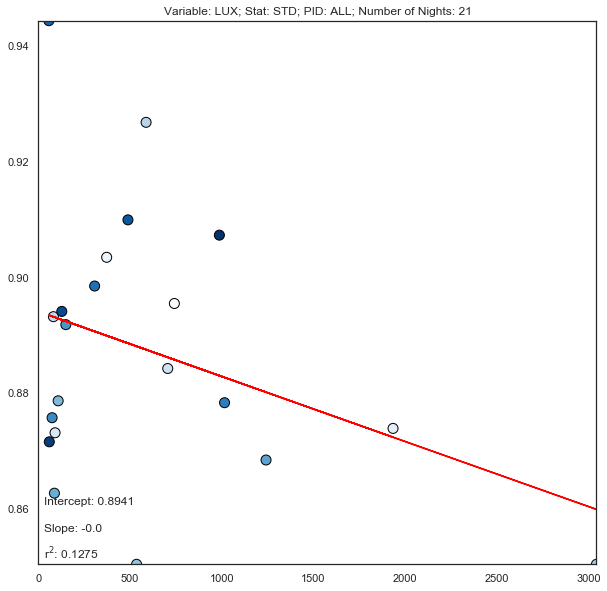

...

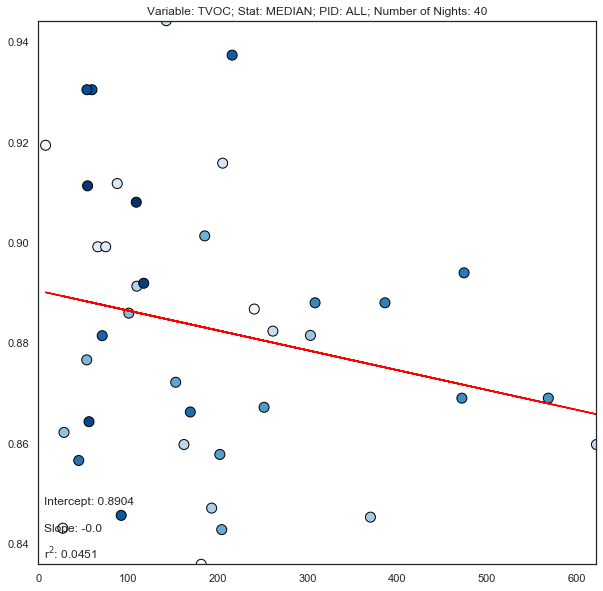

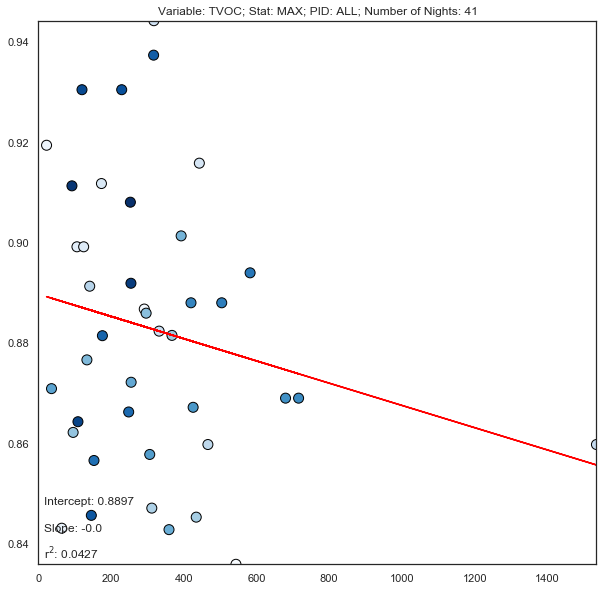

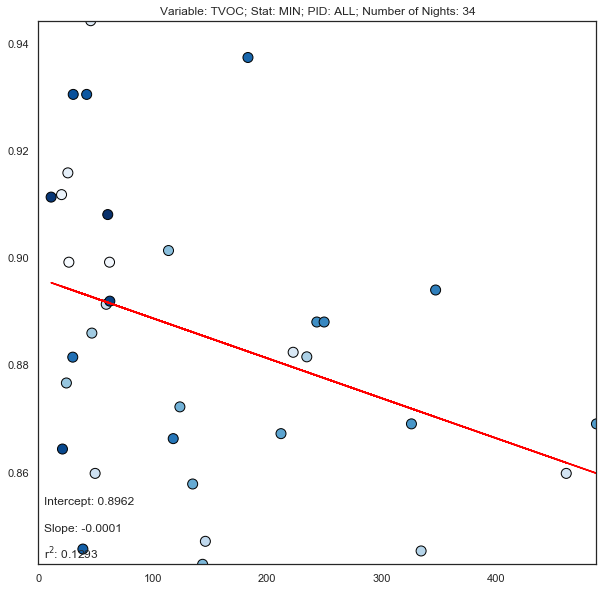

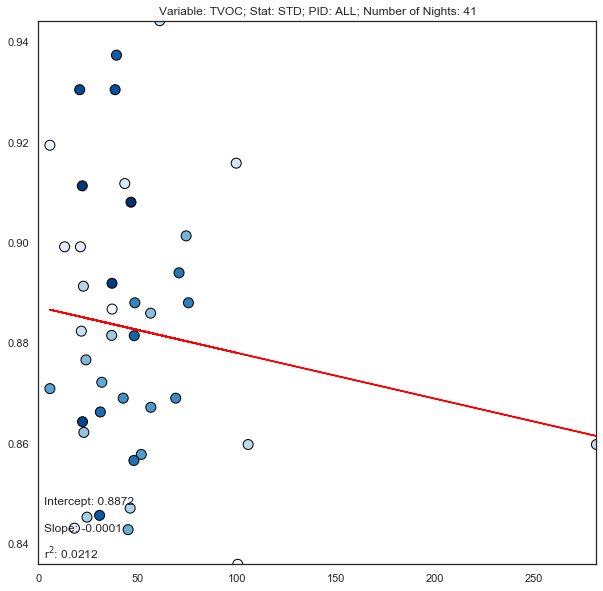

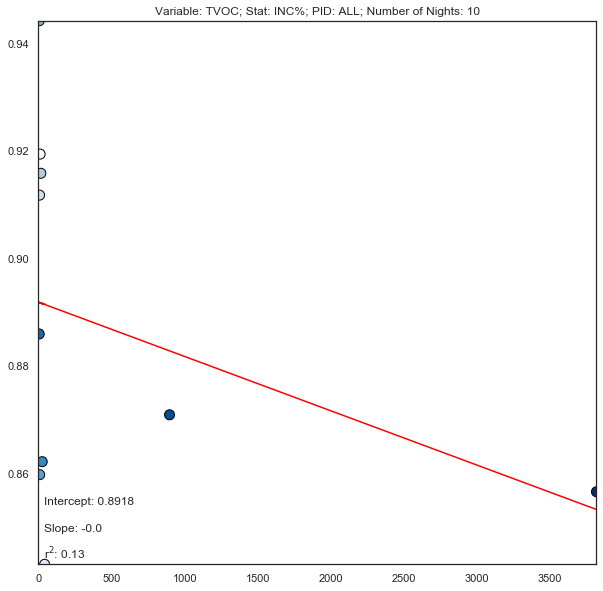

In [103]:
results_df = pd.DataFrame()
# Looping through each of the variables in py3
for var in df_py3['var'].unique():
    if var in ['eCO2']:
        continue
    
    # Masking by variables - still has all participants
    df_py3_byvar = df_py3[df_py3['var'] == var]
    
    # Looping through all the statistics - skipping over the ID and var columns
    for column in df_py3_byvar.columns:
        if column in ['ID','var']:
            continue
        
        # Looping through all the participants
        overall = pd.DataFrame()
        for pid in df_py3_byvar['ID'].unique():
            dep_vars_ind = df_py3_byvar[df_py3_byvar['ID'] == pid]
            indep_vars_ind = df_ss[df_ss['ID'] == pid]
            combined = pd.concat([dep_vars_ind,indep_vars_ind],join='inner',axis=1)
            
            combined = combined[combined['Efficiency'] > 0]

            if var in ['TVOC']:
                combined = combined[combined[column] > 5]
                
            if var in ['Lux', 'Visible']:
                combined = combined[combined[column] > 50]
                combined = combined[combined[column] < 10000]
                
            X = combined[column].values
            y = combined['Efficiency'].values

            if len(X) > 1:
                ax, model = plotLinearRegression(X,[0,500],y,[0.7,1],False)
                try:
                    ax.set_title(f'PID: {pid.upper()}; Number of Nights: {len(combined)}')
                    plt.show()
                    plt.close()
                except:
                    pass

                overall = pd.concat([overall,combined])
            else:
                pass

        if len(overall) > 1:
            X = overall[column].values
            y = overall['Efficiency'].values
            
            ax, model = plotLinearRegression(X,[0,max(X)],y,[min(y),max(y)],True)
            try:
                ax.set_title(f'Variable: {var.upper()}; Stat: {column.upper()}; PID: ALL; Number of Nights: {len(overall)}')
                plt.show()
                plt.close()
            except:
                pass

            onevar_df = pd.DataFrame(data={'Variable':[var],'Stat':[column.upper()],'Outcome':['sleep_efficiency'.upper()],
                                          'x0':[model.params[0]],'x1':[model.params[1]],'No. Points':[len(overall)],'Fit':[model.rsquared]})

            results_df = pd.concat([results_df,onevar_df])

#### Results for Python 3 Sensnors
Below the results for the one variable linear regression are summarized.

In [96]:
results_df

,Variable,Stat,Outcome,x0,x1,No. Points,Fit
0,Lux,MEAN,SLEEP_EFFICIENCY,0.894828,-2.015689e-05,14,0.263092
0,Lux,MAX,SLEEP_EFFICIENCY,0.881344,1.689372e-06,36,0.008504
0,Lux,STD,SLEEP_EFFICIENCY,0.894052,-1.121878e-05,21,0.127469
0,Lux,INC%,SLEEP_EFFICIENCY,0.876616,6.281425e-06,32,0.023142
0,Visible,MEAN,SLEEP_EFFICIENCY,0.874240,8.007552e-11,179,0.000481
0,Visible,MEDIAN,SLEEP_EFFICIENCY,0.874300,1.229448e-10,179,0.000466
0,Visible,MAX,SLEEP_EFFICIENCY,0.874264,6.135296e-12,179,0.000338
0,Visible,MIN,SLEEP_EFFICIENCY,0.874324,6.849851e-10,179,0.000096
0,Visible,STD,SLEEP_EFFICIENCY,0.874028,1.092789e-10,179,0.002207
0,Visible,INC%,SLEEP_EFFICIENCY,0.874286,5.314214e-12,179,0.000249


Based on the results above, the variables that seemed to affect sleep efficiency to some degree were:
- % Inc Temperature
- STD RH
- % Inc RH
- Mean CO
- Median CO
- Min CO
- Mean TVOC
- Median TVOC
- Max TVOC
- STD TVOC
- % Inc TVOC

#### Python 2 Sensors
Now we look at the sensors that collect data with Python 2. 

Limited data for participant vd2ajjap


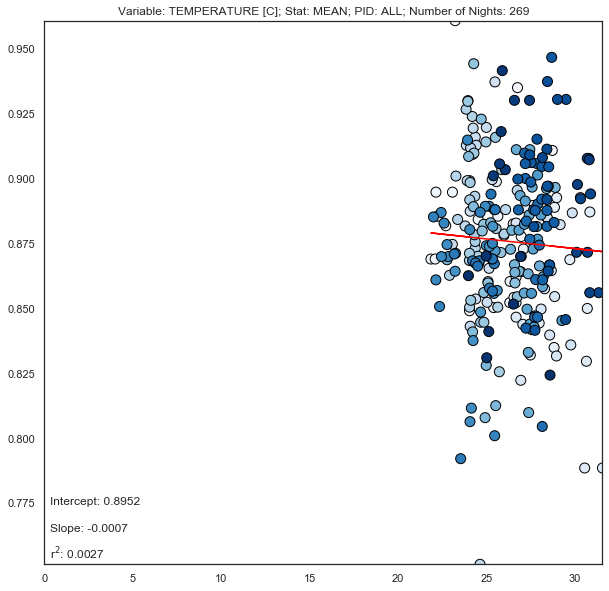

Limited data for participant vd2ajjap


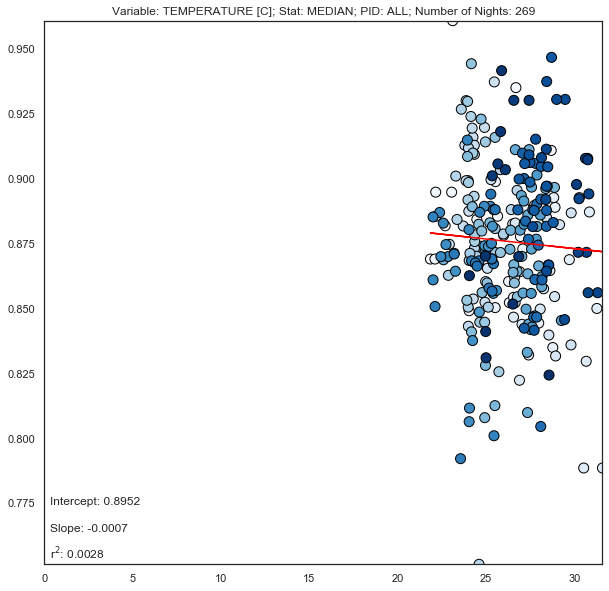

Limited data for participant vd2ajjap


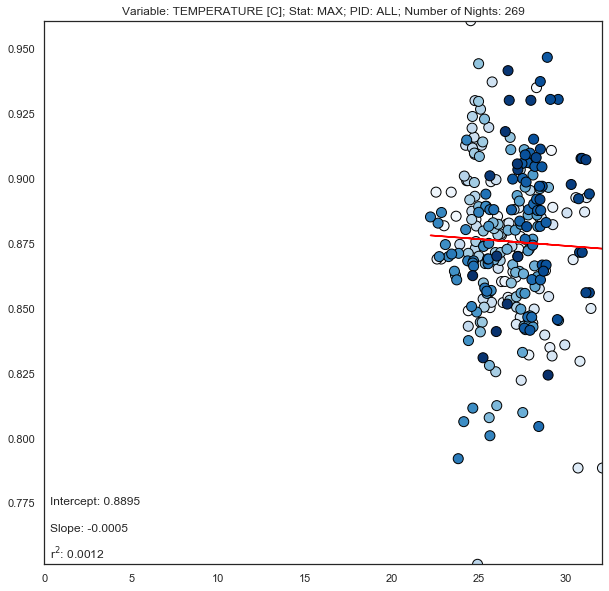

Limited data for participant vd2ajjap


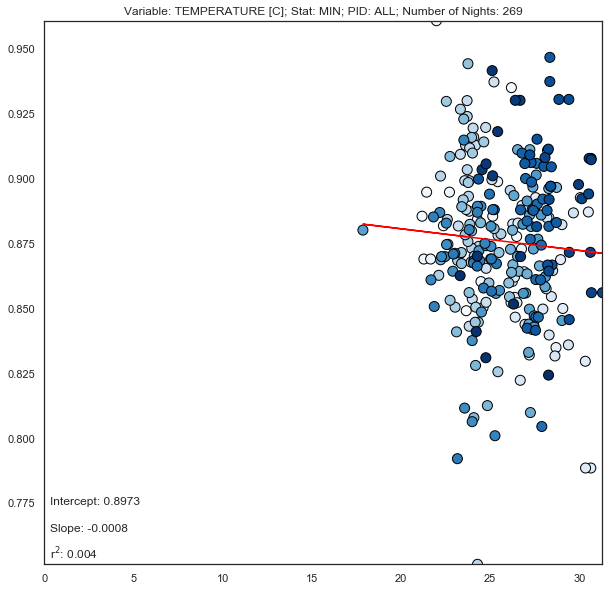

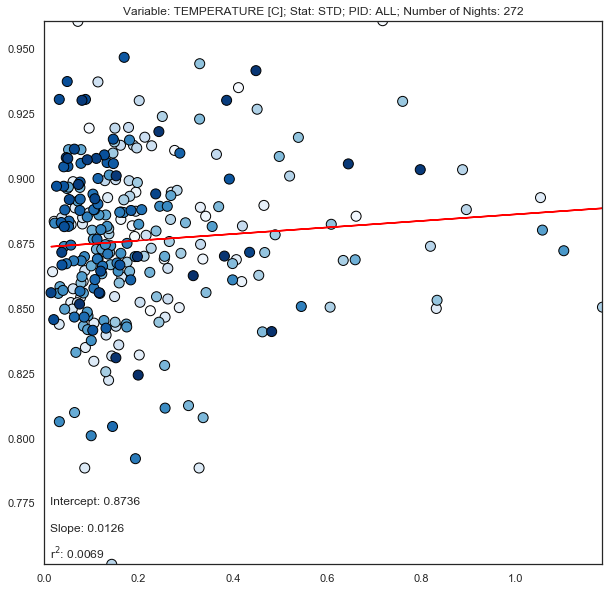

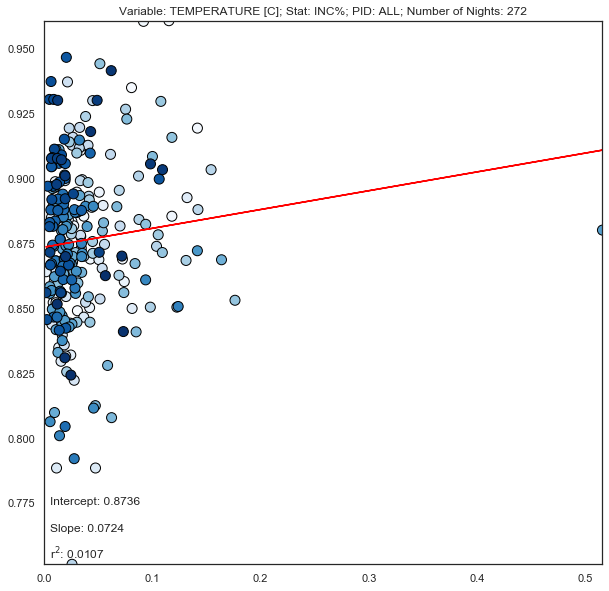

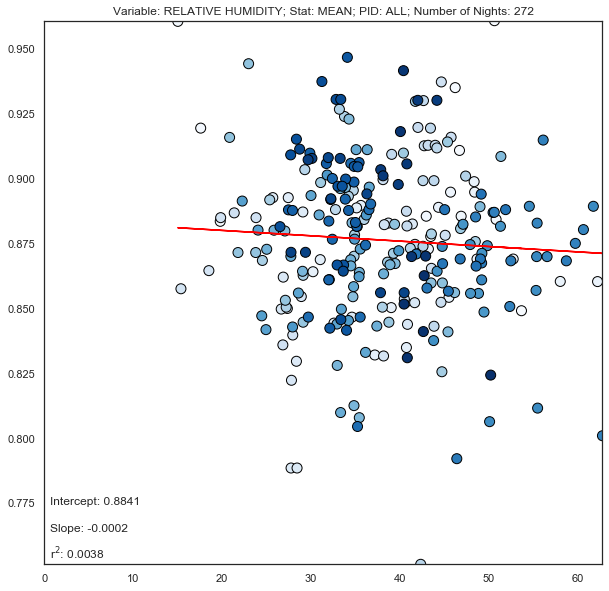

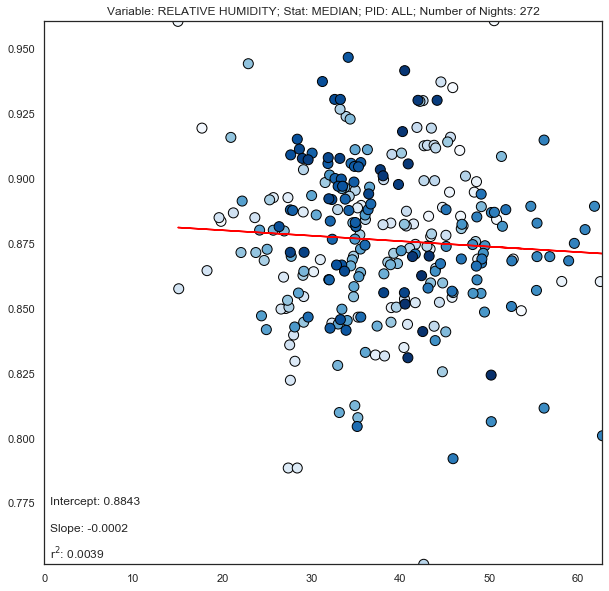

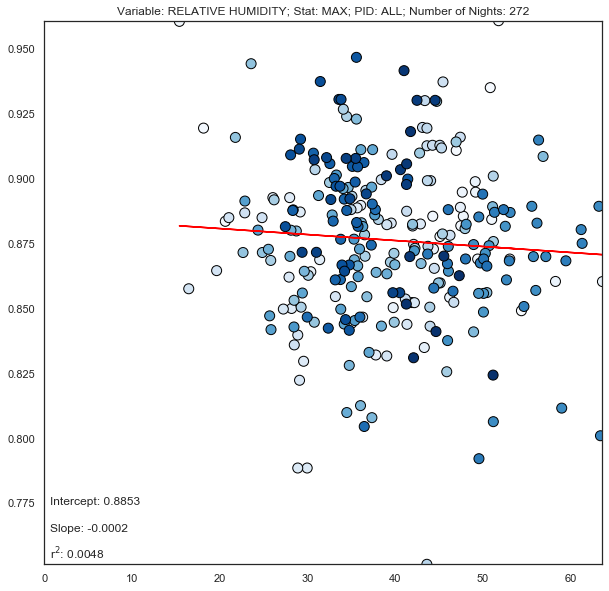

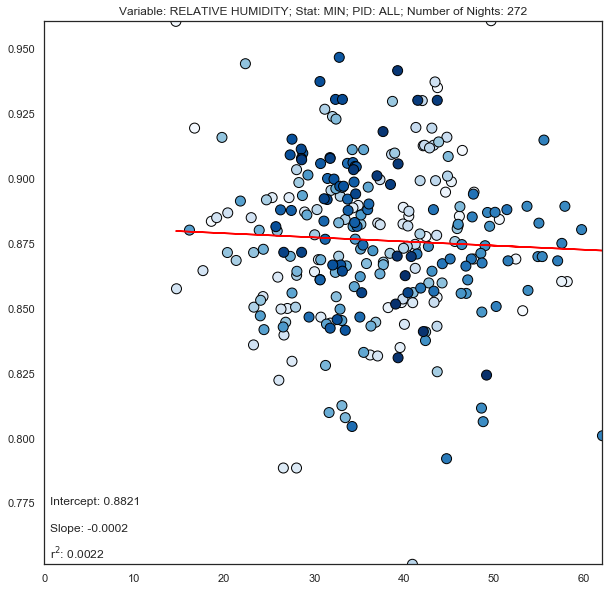

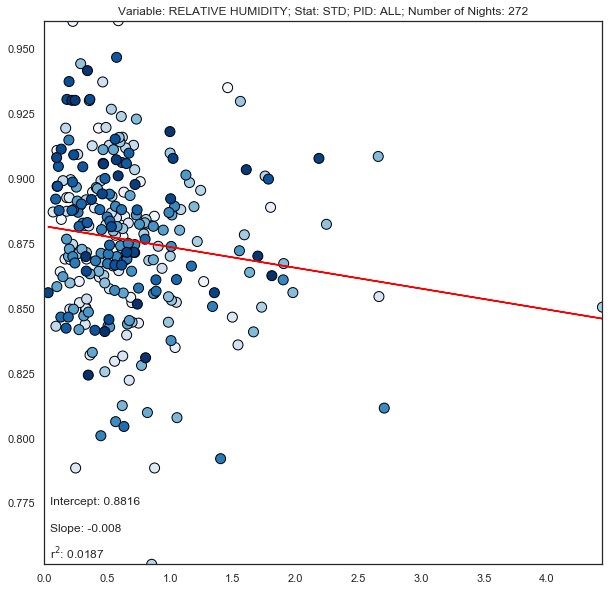

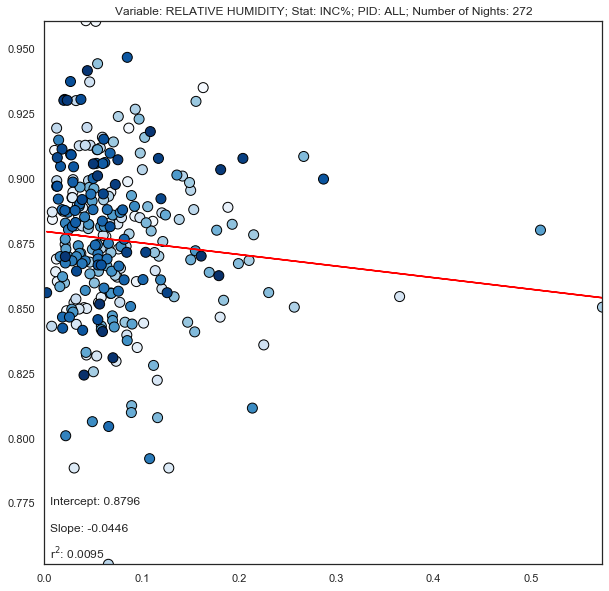

Limited data for participant 8l17qdhp
Limited data for participant o7g2lmna
Limited data for participant oijvf1fo
Limited data for participant z7trat1j
Limited data for participant ng31u6a6
Limited data for participant pho7eama
Limited data for participant daneytpw


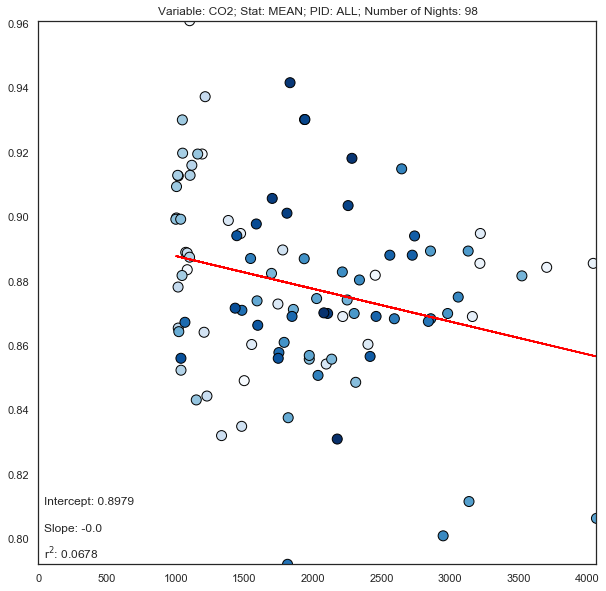

Limited data for participant 8l17qdhp
Limited data for participant o7g2lmna
Limited data for participant oijvf1fo
Limited data for participant z7trat1j
Limited data for participant ng31u6a6
Limited data for participant pho7eama
Limited data for participant daneytpw


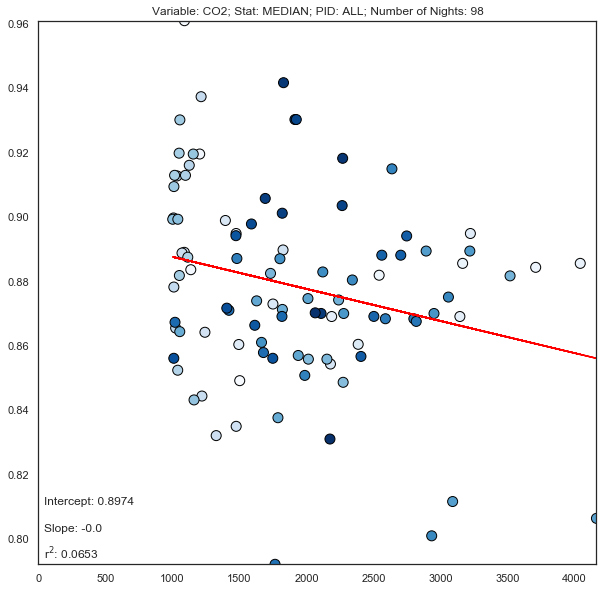

Limited data for participant 8l17qdhp
Limited data for participant o7g2lmna
Limited data for participant oijvf1fo
Limited data for participant z7trat1j
Limited data for participant pho7eama


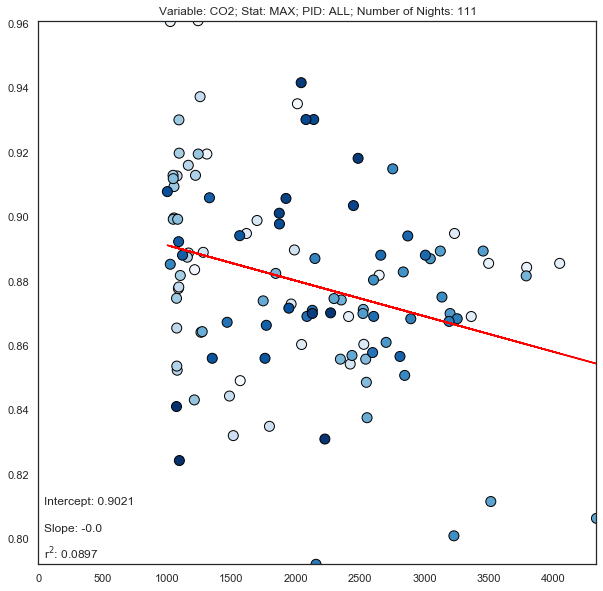

Limited data for participant 332b3bxa
Limited data for participant vd2ajjap
Limited data for participant 8l17qdhp
Limited data for participant o7g2lmna
Limited data for participant oijvf1fo
Limited data for participant z7trat1j
Limited data for participant ng31u6a6
Limited data for participant pho7eama
Limited data for participant daneytpw


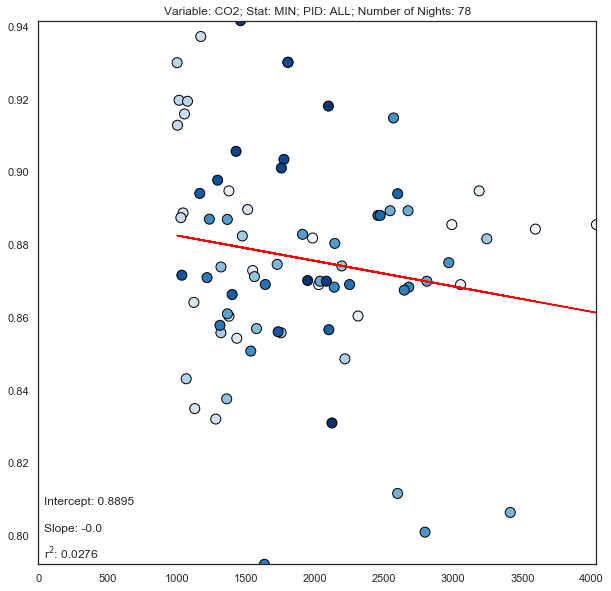

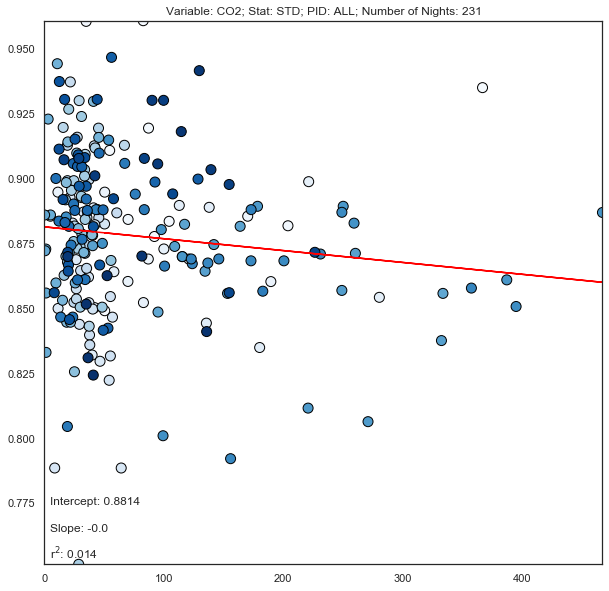

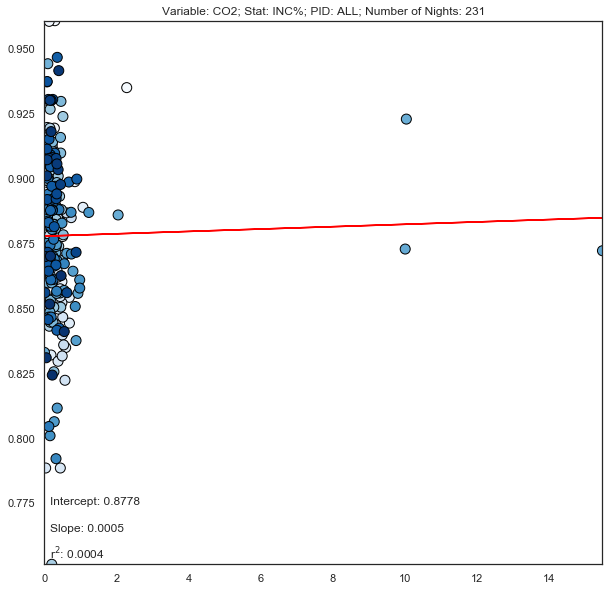

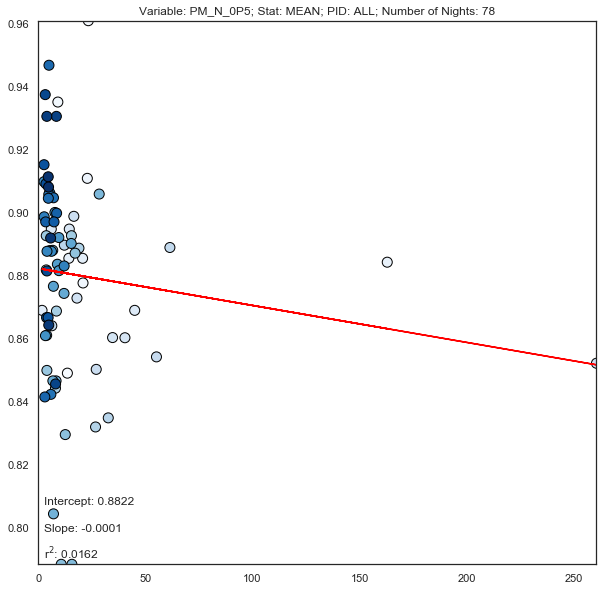

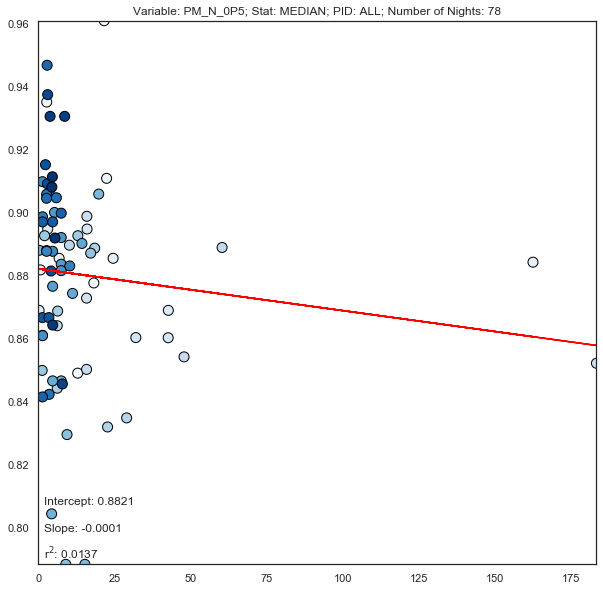

...

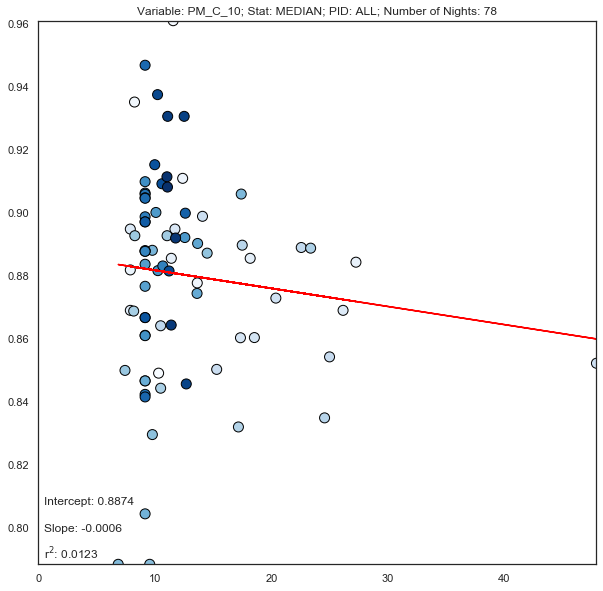

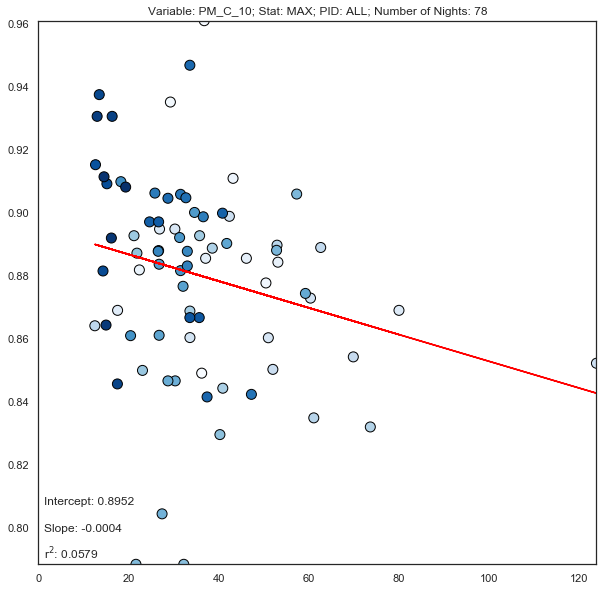

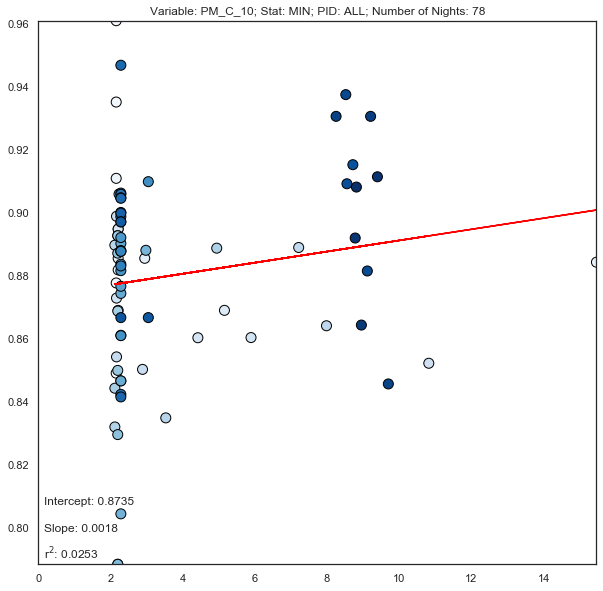

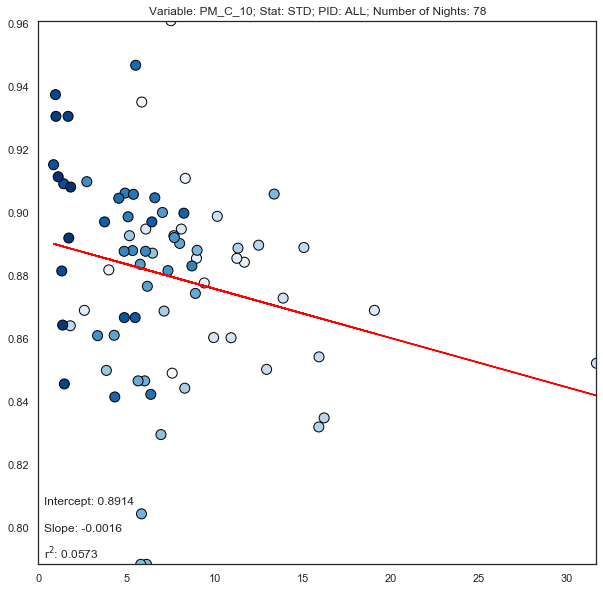

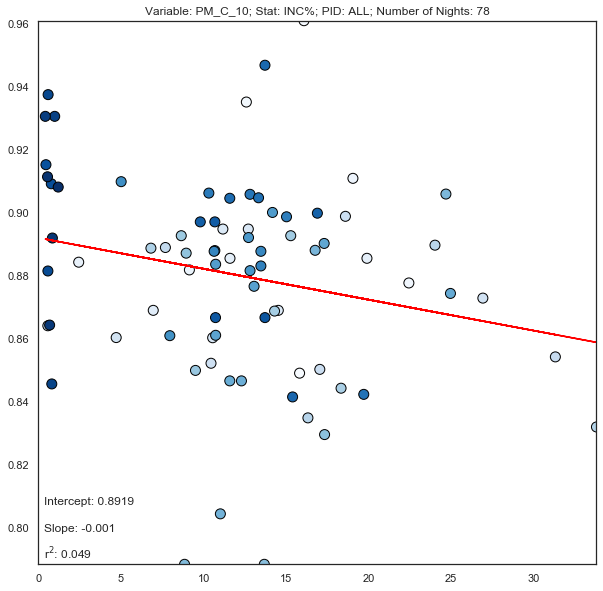

In [105]:
results_df = pd.DataFrame()
# Looping through each of the variables in py2
for var in df_py2['var'].unique():
    
    # Masking by variables - still has all participants
    df_py2_byvar = df_py2[df_py2['var'] == var]
    
    # Looping through all the statistics - skipping over the ID and var columns
    for column in df_py2_byvar.columns:
        if column in ['ID','var']:
            continue
        
        # Looping through all the participants
        overall = pd.DataFrame()
        for pid in df_py2_byvar['ID'].unique():
            dep_vars_ind = df_py2_byvar[df_py2_byvar['ID'] == pid]
            indep_vars_ind = df_ss[df_ss['ID'] == pid]
            combined = pd.concat([dep_vars_ind,indep_vars_ind],join='inner',axis=1)
            
            combined = combined[combined['Efficiency'] > 0]
            
            if var == 'Temperature [C]' and column in ['mean','median','min','max']:
                combined = combined[combined[column] > 15]
                
            if var == 'CO2' and column in ['mean','median','min','max']:
                combined = combined[combined[column] > 1000]
                
            X = combined[column].values
            y = combined['Efficiency'].values

            if len(X) > 1:
                ax, model = plotLinearRegression(X,[0,500],y,[0.7,1],False)
                try:
                    ax.set_title(f'PID: {pid.upper()}; Number of Nights: {len(combined)}')
                    plt.show()
                    plt.close()
                except:
                    pass

                overall = pd.concat([overall,combined])
            else:
                print(f'Limited data for participant {pid}')

        X = overall[column].values
        y = overall['Efficiency'].values

        ax, model = plotLinearRegression(X,[0,max(X)],y,[min(y),max(y)],True)
        try:
            ax.set_title(f'Variable: {var.upper()}; Stat: {column.upper()}; PID: ALL; Number of Nights: {len(overall)}')
            plt.show()
            plt.close()
        except:
            pass

        onevar_df = pd.DataFrame(data={'Variable':[var],'Stat':[column.upper()],'Outcome':['sleep_efficiency'.upper()],
                                      'x0':[model.params[0]],'x1':[model.params[1]],'No. Points':[len(overall)],'Fit':[model.rsquared]})

        results_df = pd.concat([results_df,onevar_df])

#### Results for Python 2 Sensnors
Below the results for the one variable linear regression are summarized.

In [50]:
results_df[results_df['Variable'] == 'PM_C_2p5']

,Variable,Stat,Outcome,x0,x1,No. Points,Fit
0,PM_C_2p5,MEAN,SLEEP_EFFICIENCY,0.887052,-0.000731,78,0.017861
0,PM_C_2p5,MEDIAN,SLEEP_EFFICIENCY,0.886229,-0.000730,78,0.013691
0,PM_C_2p5,MAX,SLEEP_EFFICIENCY,0.891881,-0.000530,78,0.050007
0,PM_C_2p5,MIN,SLEEP_EFFICIENCY,0.876720,0.001070,78,0.005011
0,PM_C_2p5,STD,SLEEP_EFFICIENCY,0.888407,-0.001899,78,0.046752
0,PM_C_2p5,INC%,SLEEP_EFFICIENCY,0.892029,-0.001676,78,0.050581


Based on the results above, the variables that seemed to affect sleep efficiency to some degree were:
- % Inc Temperature
- Max PM10
- STD PM10
- %Inc PM_C_10
- Max PM_C_2p5

#### Fitbit Metrics
Now looking at any of the fitbit metrics to see if they noticeably affect the sleep outcome.

Limited data for participant nan


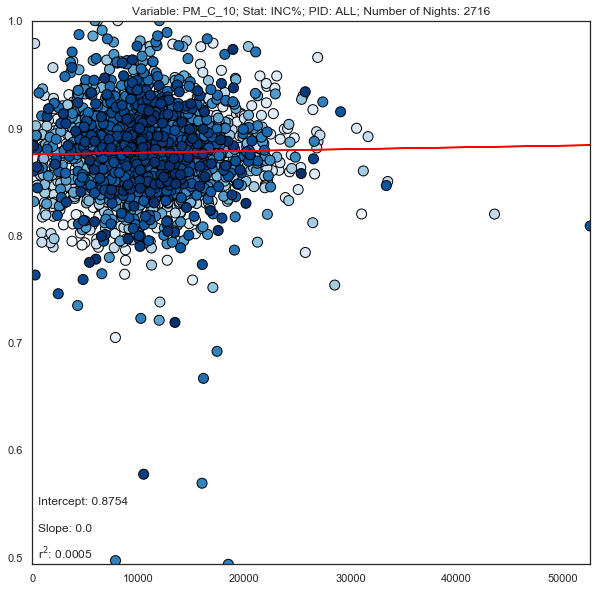

In [34]:
results_df = pd.DataFrame()

# Looping through all the participants
overall = pd.DataFrame()
for pid in df_steps['ID'].unique():
    dep_vars_ind = df_steps[df_steps['ID'] == pid]
    indep_vars_ind = df_ss[df_ss['ID'] == pid]
    combined = pd.concat([dep_vars_ind,indep_vars_ind],join='inner',axis=1)

    combined = combined[combined['Efficiency'] > 0.4]

    X = combined['StepTotal'].values
    y = combined['Efficiency'].values

    if len(X) > 1:
        ax, model = plotLinearRegression(X,[0,500],y,[0.7,1],False)
        try:
            ax.set_title(f'PID: {pid.upper()}; Number of Nights: {len(combined)}')
            plt.show()
            plt.close()
        except:
            pass

        overall = pd.concat([overall,combined])
    else:
        print(f'Limited data for participant {pid}')

X = overall['StepTotal'].values
y = overall['Efficiency'].values

ax, model = plotLinearRegression(X,[0,max(X)],y,[min(y),max(y)],True)
try:
    ax.set_title(f'Variable: {var.upper()}; Stat: {column.upper()}; PID: ALL; Number of Nights: {len(overall)}')
    plt.show()
    plt.close()
except:
    pass

onevar_df = pd.DataFrame(data={'Variable':['StepTotal'],'Stat':['Total'],'Outcome':['sleep_efficiency'.upper()],
                              'x0':[model.params[0]],'x1':[model.params[1]],'No. Points':[len(overall)],'Fit':[model.rsquared]})

results_df = pd.concat([results_df,onevar_df])

#### Results for Fitbit

In [35]:
results_df

,Variable,Stat,Outcome,x0,x1,No. Points,Fit
0,StepTotal,Total,SLEEP_EFFICIENCY,0.875398,1.628920e-07,2716,0.000458


#### Mood

/Users/hagenfritz/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


exog contains inf or nans
Limited data for participant hrzjncys
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans


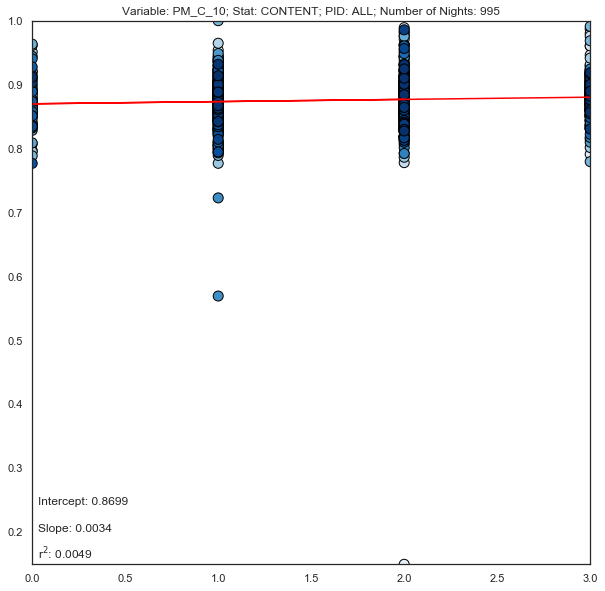

/Users/hagenfritz/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


exog contains inf or nans
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans


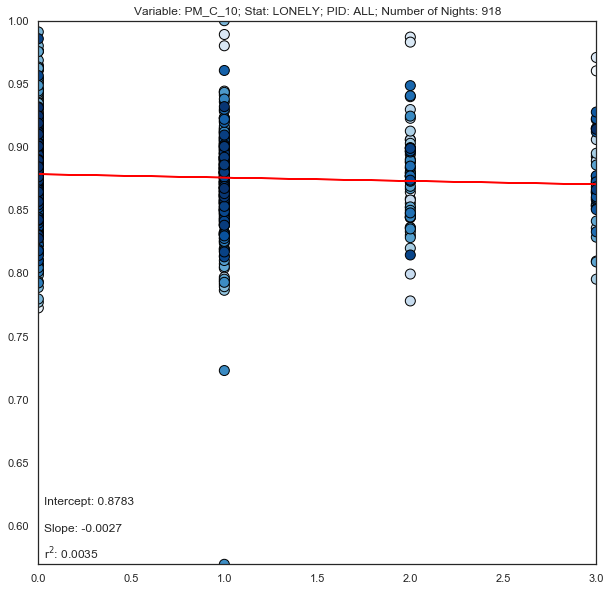

/Users/hagenfritz/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


exog contains inf or nans
exog contains inf or nans
exog contains inf or nans
Limited data for participant hrzjncys
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans


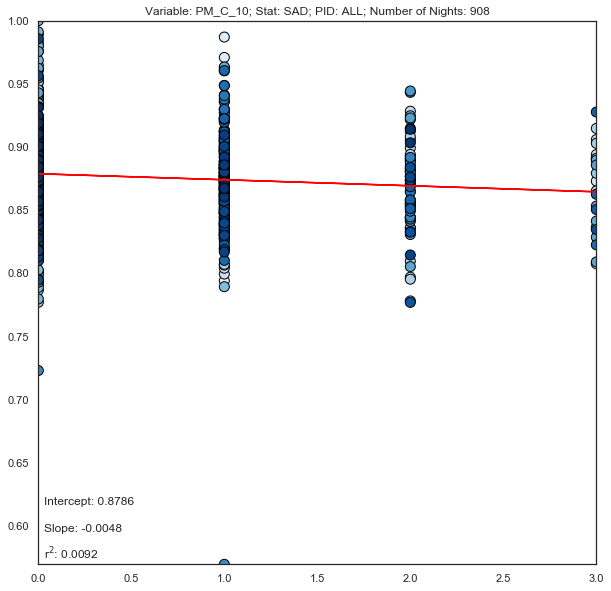

/Users/hagenfritz/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


exog contains inf or nans
exog contains inf or nans
exog contains inf or nans
Limited data for participant hrzjncys
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans


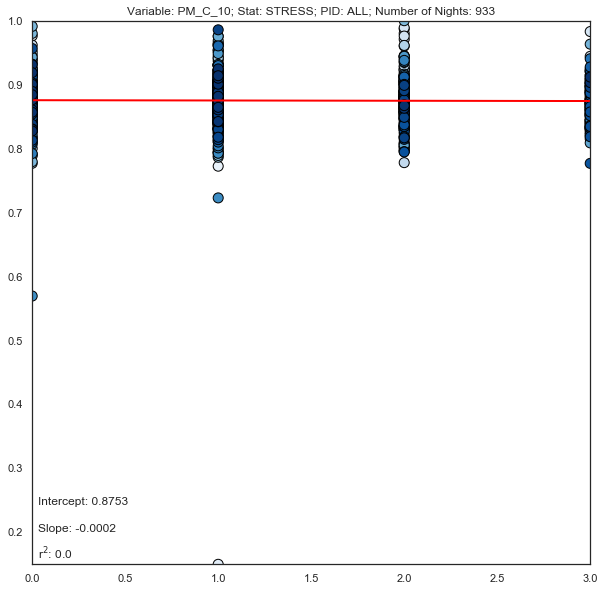

/Users/hagenfritz/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


exog contains inf or nans
exog contains inf or nans
exog contains inf or nans
Limited data for participant hrzjncys
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans


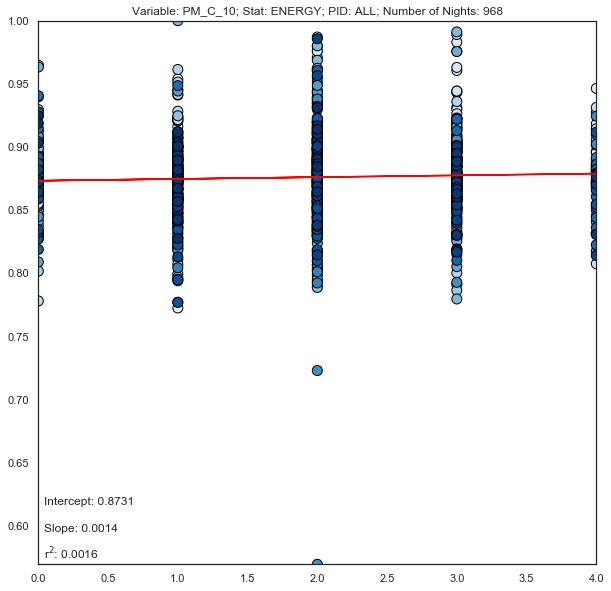

In [37]:
results_df = pd.DataFrame()
    
# Looping through all the moods - skipping over the ID and submitted columns
for column in df_evening.columns:
    if column in ['ID','Submitted','date']:
        continue

    # Looping through all the participants
    overall = pd.DataFrame()
    for pid in df_evening['ID'].unique():
        dep_vars_ind = df_evening[df_evening['ID'] == pid]
        dep_vars_ind['day'] = dep_vars_ind.index.date
        dep_vars_ind = dep_vars_ind.set_index('day')
        indep_vars_ind = df_ss[df_ss['ID'] == pid]
        combined = dep_vars_ind.merge(right=indep_vars_ind,how='inner',right_index=True,left_index=True)
        #combined = pd.concat([dep_vars_ind,indep_vars_ind],join='inner',axis=1)

        combined = combined[combined['Efficiency'] > 0]

        X = combined[column].values
        y = combined['Efficiency'].values
        
        if np.sum(X) == 0:
            continue
        
        if len(X) > 1:
            ax, model = plotLinearRegression(X,[0,4],y,[0.7,1],False)
            try:
                ax.set_title(f'PID: {pid.upper()}; Number of Nights: {len(combined)}')
                plt.show()
                plt.close()
            except:
                pass
            if model:
                overall = pd.concat([overall,combined])
        else:
            print(f'Limited data for participant {pid}')

    X = overall[column].values
    y = overall['Efficiency'].values

    ax, model = plotLinearRegression(X,[0,max(X)],y,[min(y),max(y)],True)
    try:
        ax.set_title(f'Variable: {var.upper()}; Stat: {column.upper()}; PID: ALL; Number of Nights: {len(overall)}')
        plt.show()
        plt.close()
        
        onevar_df = pd.DataFrame(data={'Variable':[var],'Stat':[column.upper()],'Outcome':['sleep_efficiency'.upper()],
                                  'x0':[model.params[0]],'x1':[model.params[1]],'No. Points':[len(overall)],'Fit':[model.rsquared]})

        results_df = pd.concat([results_df,onevar_df])
    except:
        pass
    

#### Mood Results

In [38]:
results_df

,Variable,Stat,Outcome,x0,x1,No. Points,Fit
0,PM_C_10,CONTENT,SLEEP_EFFICIENCY,0.869905,0.003447,995,0.004860
0,PM_C_10,LONELY,SLEEP_EFFICIENCY,0.878283,-0.002684,918,0.003500
0,PM_C_10,SAD,SLEEP_EFFICIENCY,0.878636,-0.004770,908,0.009156
0,PM_C_10,STRESS,SLEEP_EFFICIENCY,0.875302,-0.000222,933,0.000023
0,PM_C_10,ENERGY,SLEEP_EFFICIENCY,0.873102,0.001418,968,0.001643


### Ratio of REM:nREM
Now we use the ratio of REM to nREM as our outcome variable.

#### Python 3 Sensors

Limited data for participant 332b3bxa
Limited data for participant vd2ajjap
Limited data for participant faz8lf76
Limited data for participant 7ri18iba
Limited data for participant o7g2lmna
Limited data for participant f2tdu9gn
Limited data for participant z7trat1j
Limited data for participant 6ftd5dn6
Limited data for participant ng31u6a6
Limited data for participant pho7eama
Limited data for participant daneytpw


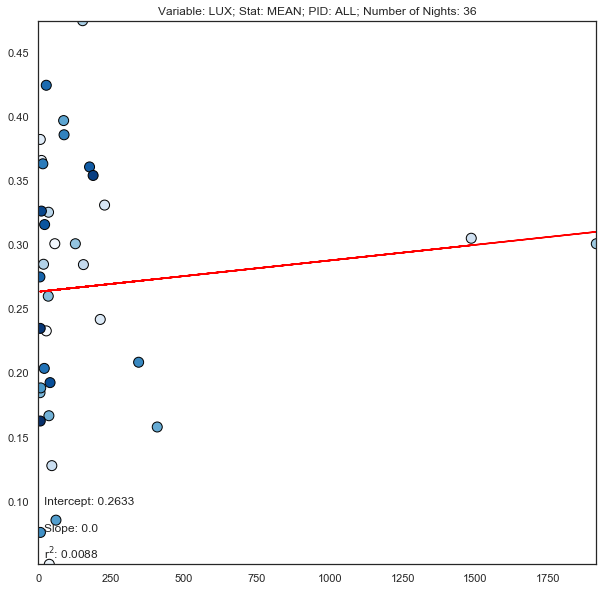

Limited data for participant 332b3bxa
Limited data for participant vd2ajjap
Limited data for participant faz8lf76
Limited data for participant 7ri18iba
Limited data for participant o7g2lmna
Limited data for participant f2tdu9gn
Limited data for participant z7trat1j
Limited data for participant 6ftd5dn6
Limited data for participant ng31u6a6
Limited data for participant pho7eama
Limited data for participant hrzjncys
Limited data for participant 7v4s12kl
Limited data for participant daneytpw


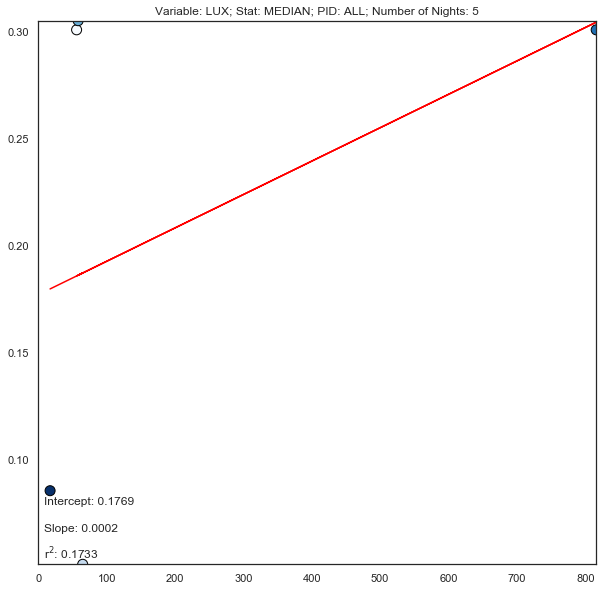

Limited data for participant vd2ajjap
Limited data for participant faz8lf76
Limited data for participant o7g2lmna
Limited data for participant f2tdu9gn
Limited data for participant ng31u6a6
Limited data for participant pho7eama


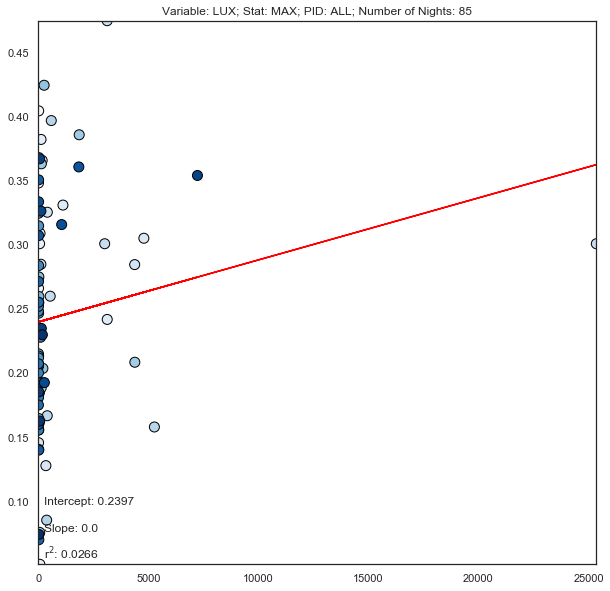

Limited data for participant 332b3bxa
Limited data for participant vd2ajjap
Limited data for participant faz8lf76
Limited data for participant 7ri18iba
Limited data for participant o7g2lmna
Limited data for participant f2tdu9gn
Limited data for participant oijvf1fo
Limited data for participant z7trat1j
Limited data for participant 6ftd5dn6
Limited data for participant ng31u6a6
Limited data for participant pho7eama
Limited data for participant hrzjncys
Limited data for participant 7v4s12kl
Limited data for participant daneytpw


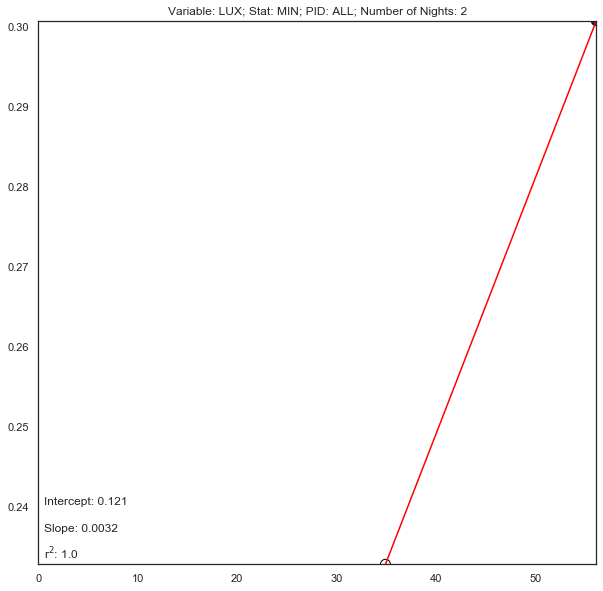

Limited data for participant 332b3bxa
Limited data for participant vd2ajjap
Limited data for participant faz8lf76
Limited data for participant 7ri18iba
Limited data for participant o7g2lmna
Limited data for participant f2tdu9gn
Limited data for participant ng31u6a6
Limited data for participant pho7eama


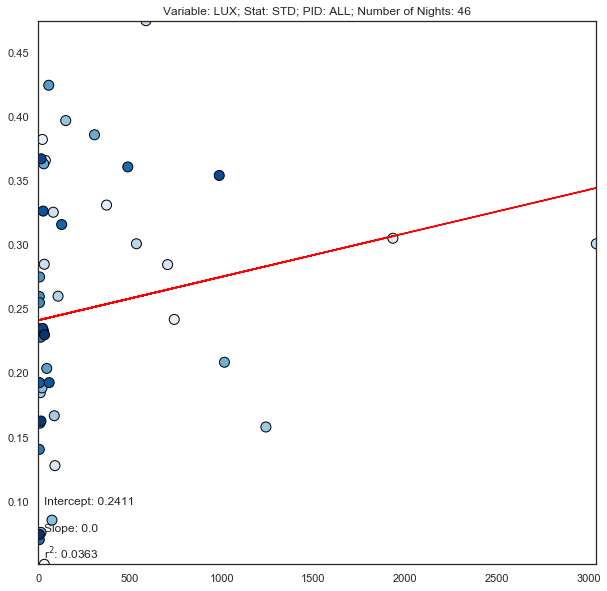

Limited data for participant vd2ajjap
Limited data for participant f2tdu9gn
Limited data for participant pho7eama
Limited data for participant daneytpw


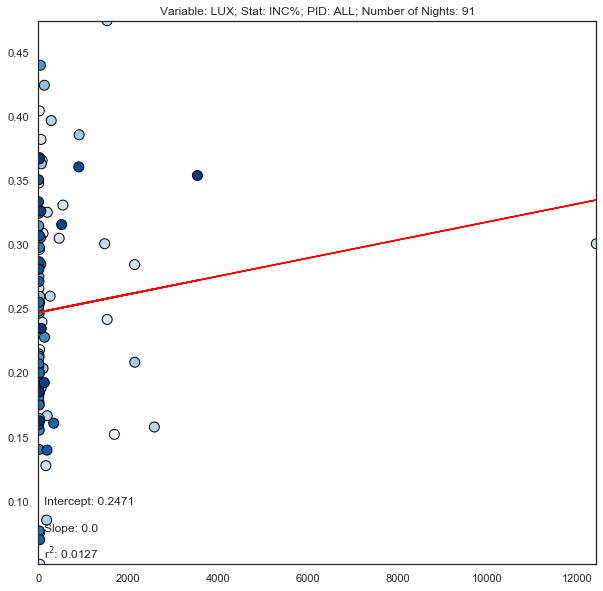

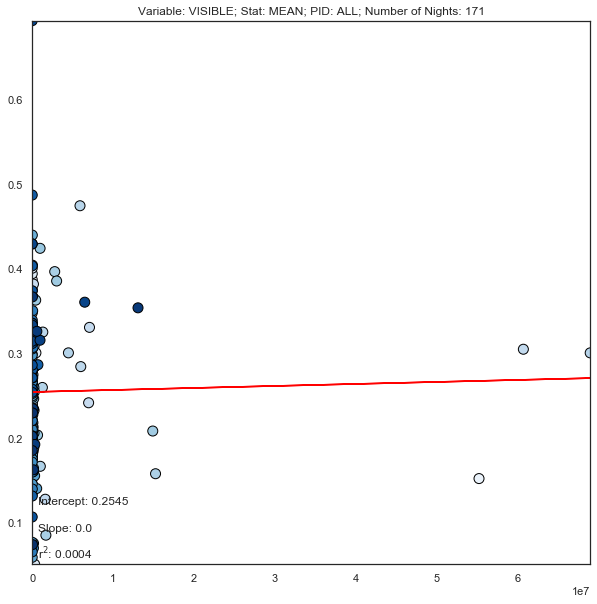

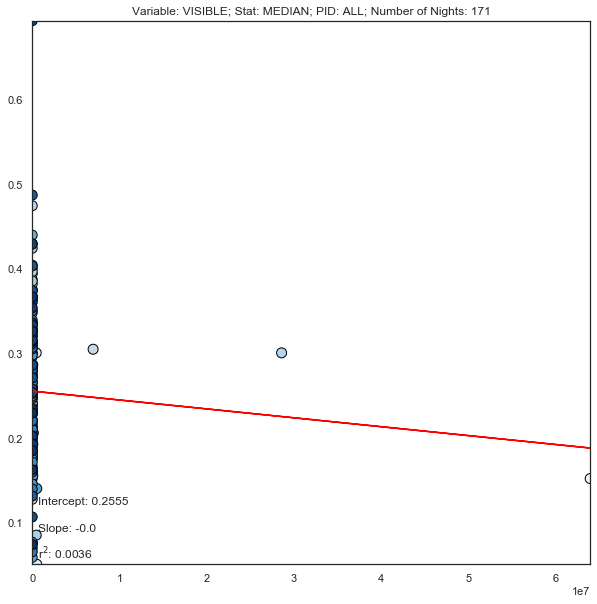

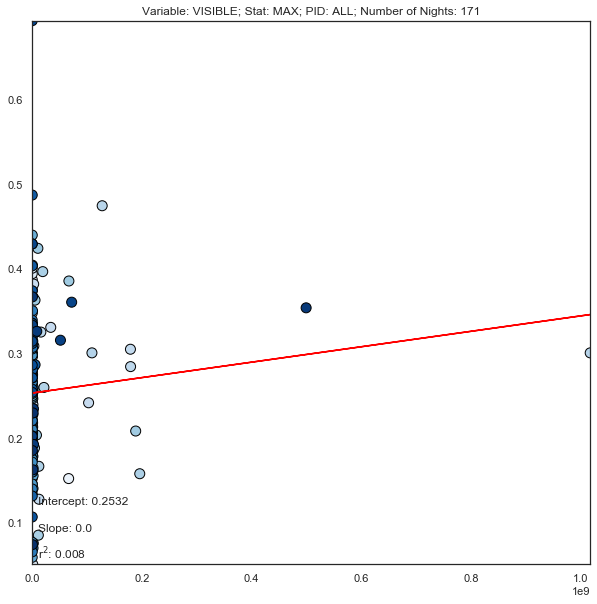

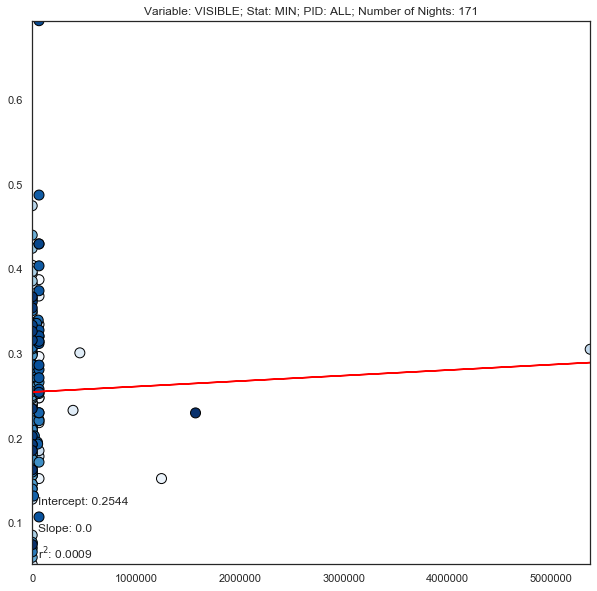

...

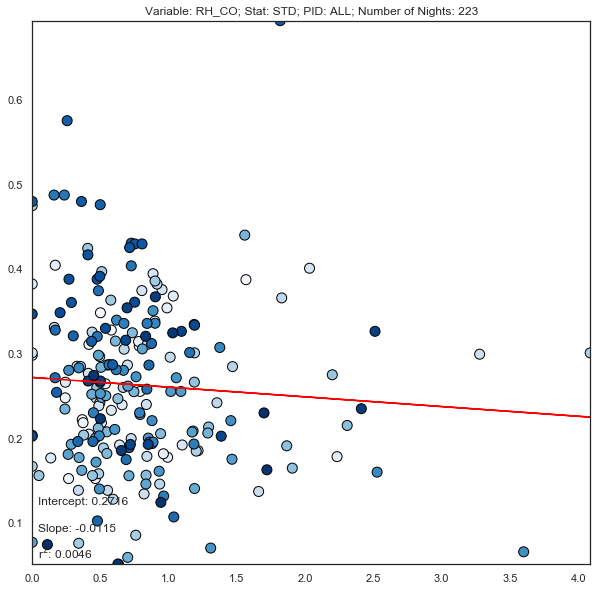

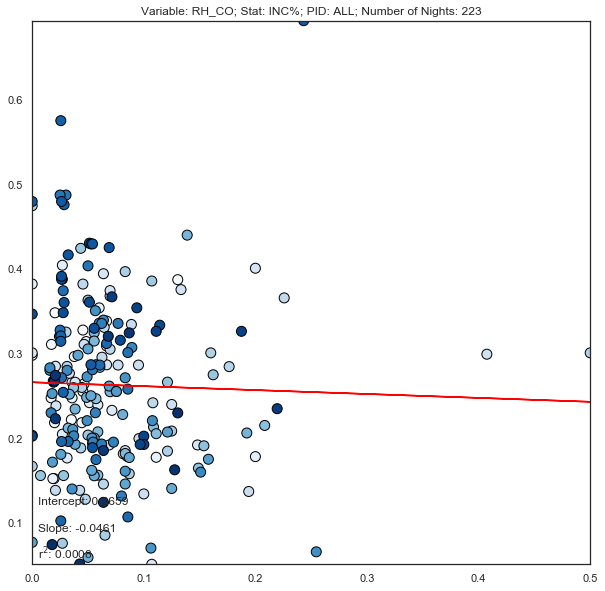

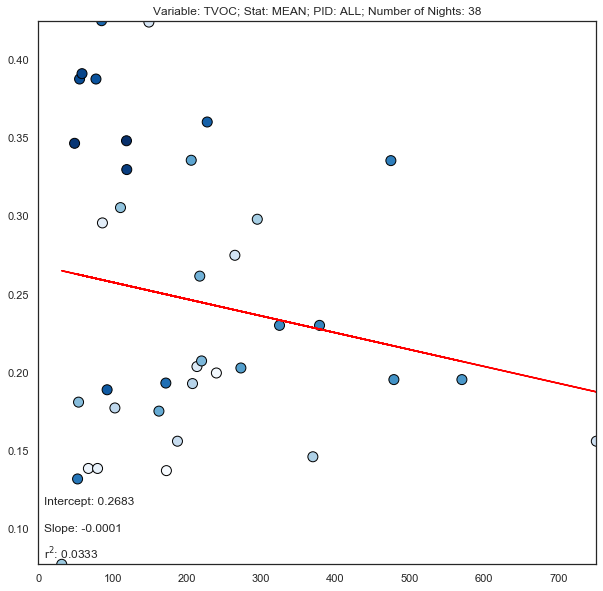

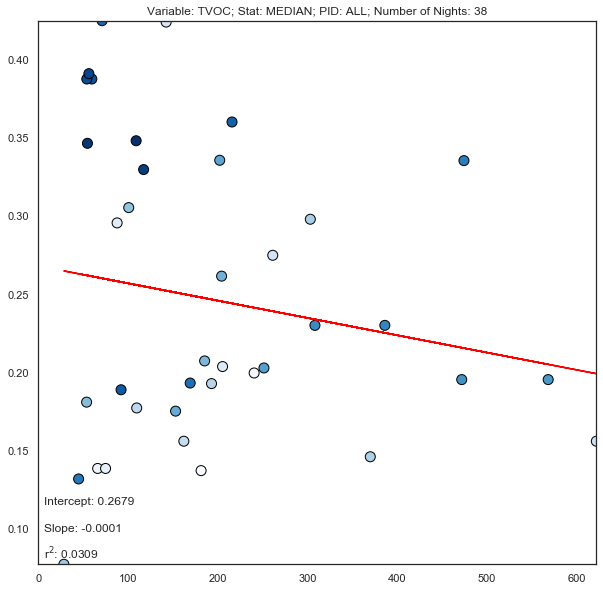

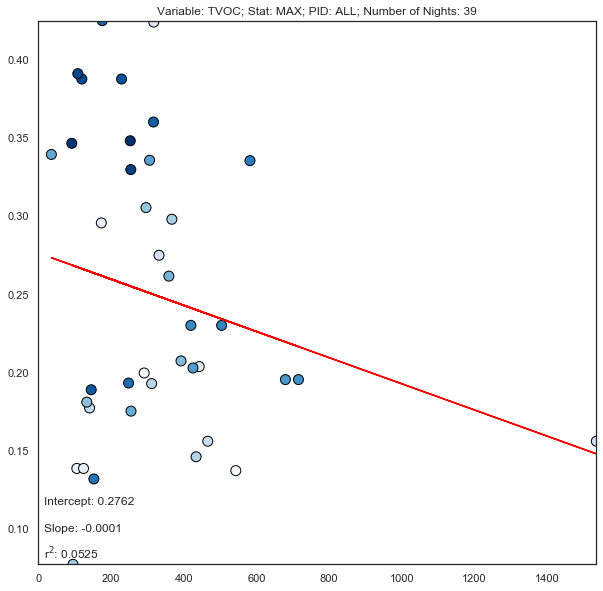

Limited data for participant o7g2lmna


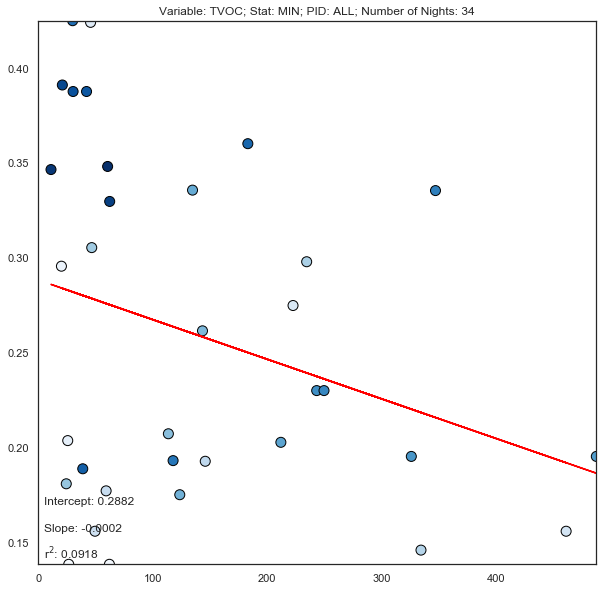

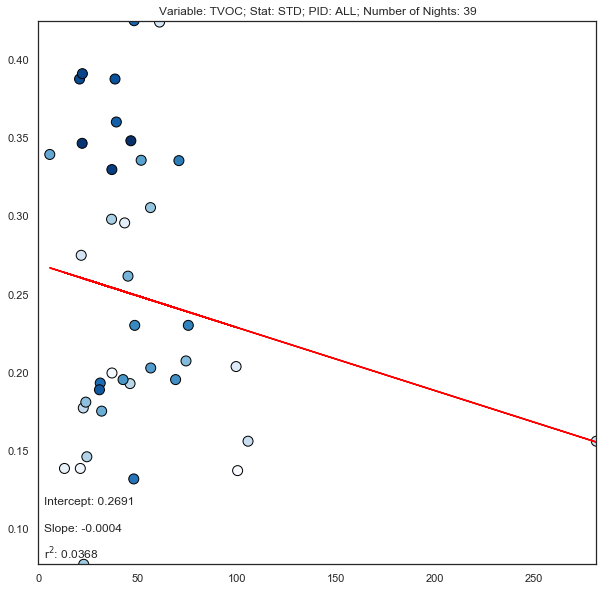

Limited data for participant o7g2lmna
Limited data for participant f2tdu9gn
Limited data for participant pho7eama


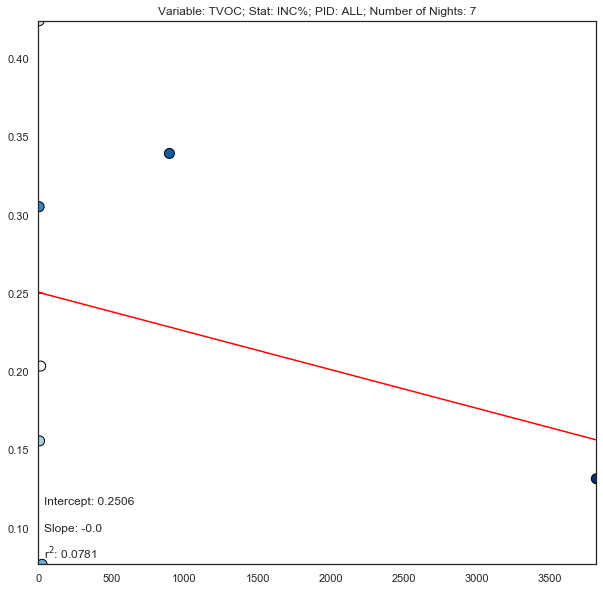

In [63]:
results_df = pd.DataFrame()
# Looping through each of the variables in py3
for var in df_py3['var'].unique():
    if var in ['eCO2']:
        continue
    
    # Masking by variables - still has all participants
    df_py3_byvar = df_py3[df_py3['var'] == var]
    
    # Looping through all the statistics - skipping over the ID and var columns
    for column in df_py3_byvar.columns:
        if column in ['ID','var']:
            continue
        
        # Looping through all the participants
        overall = pd.DataFrame()
        for pid in df_py3_byvar['ID'].unique():
            dep_vars_ind = df_py3_byvar[df_py3_byvar['ID'] == pid]
            indep_vars_ind = df_ss[df_ss['ID'] == pid]
            combined = pd.concat([dep_vars_ind,indep_vars_ind],join='inner',axis=1)
            
            combined = combined[combined['REM/nREM'] > 0]

            if var in ['TVOC','Lux']:
                combined = combined[combined[column] > 5]
                
            X = combined[column].values
            y = combined['REM/nREM'].values

            if len(X) > 1:
                ax, model = plotLinearRegression(X,[0,500],y,[0,1],False)
                try:
                    ax.set_title(f'PID: {pid.upper()}; Number of Nights: {len(combined)}')
                    plt.show()
                    plt.close()
                except:
                    pass

                overall = pd.concat([overall,combined])
            else:
                print(f'Limited data for participant {pid}')

        X = overall[column].values
        y = overall['REM/nREM'].values

        ax, model = plotLinearRegression(X,[0,max(X)],y,[min(y),max(y)],True)
        try:
            ax.set_title(f'Variable: {var.upper()}; Stat: {column.upper()}; PID: ALL; Number of Nights: {len(overall)}')
            plt.show()
            plt.close()
        except:
            pass

        onevar_df = pd.DataFrame(data={'Variable':[var],'Stat':[column.upper()],'Outcome':['REM2nREM'.upper()],
                                      'x0':[model.params[0]],'x1':[model.params[1]],'No. Points':[len(overall)],'Fit':[model.rsquared]})

        results_df = pd.concat([results_df,onevar_df])

In [62]:
results_df

,Variable,Stat,Outcome,x0,x1,No. Points,Fit
0,Lux,MEAN,REM2NREM,0.263282,2.435784e-05,36,0.008795
0,Lux,MEDIAN,REM2NREM,0.176880,1.560748e-04,5,0.173291
0,Lux,MAX,REM2NREM,0.239703,4.833242e-06,85,0.026621
0,Lux,MIN,REM2NREM,0.120957,3.201219e-03,2,1.000000
0,Lux,STD,REM2NREM,0.241061,3.385978e-05,46,0.036309
0,Lux,INC%,REM2NREM,0.247135,7.050153e-06,91,0.012748
0,Visible,MEAN,REM2NREM,0.254458,2.367953e-10,171,0.000448
0,Visible,MEDIAN,REM2NREM,0.255486,-1.051602e-09,171,0.003636
0,Visible,MAX,REM2NREM,0.253213,9.110971e-11,171,0.007950
0,Visible,MIN,REM2NREM,0.254418,6.468461e-09,171,0.000918


#### Python 2 Sensors

Limited data for participant vd2ajjap


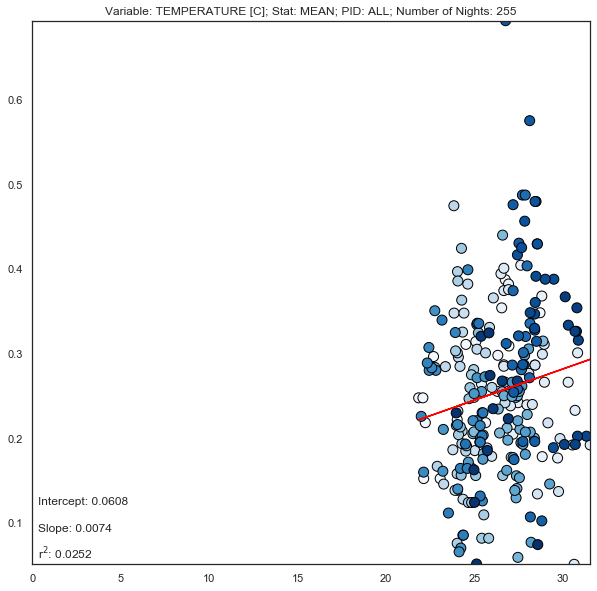

Limited data for participant vd2ajjap


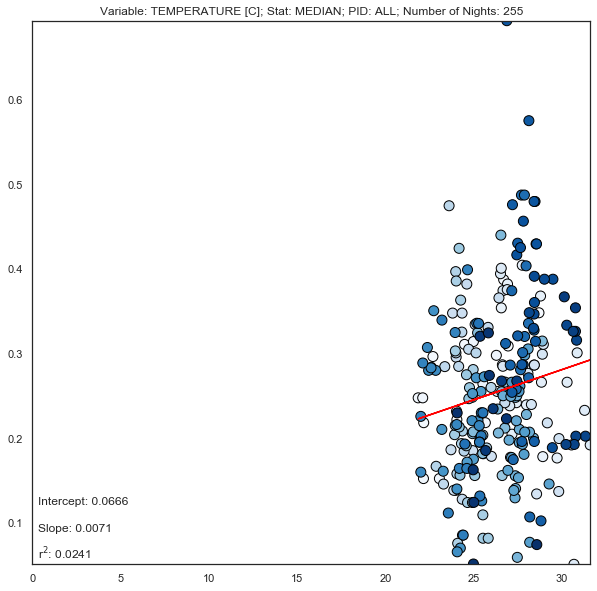

Limited data for participant vd2ajjap


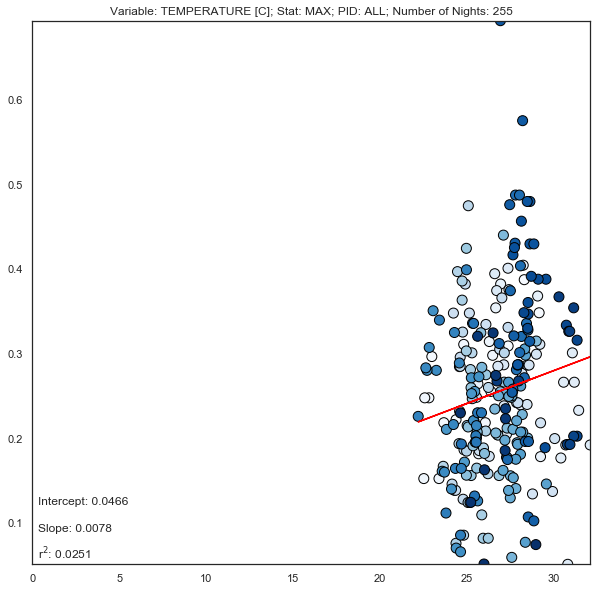

Limited data for participant vd2ajjap


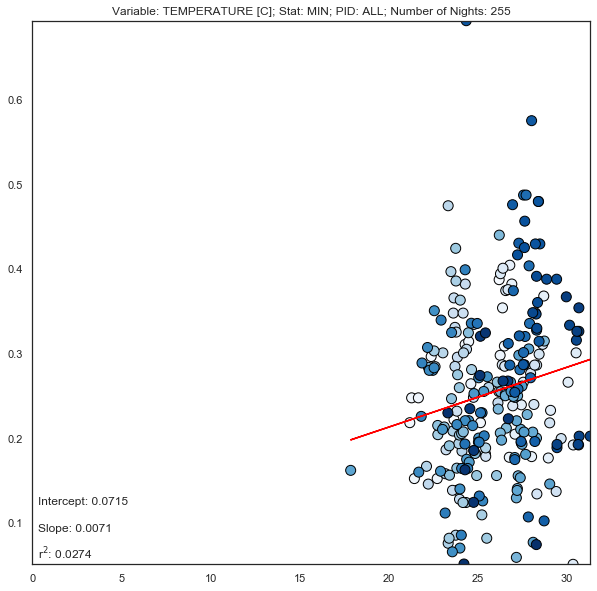

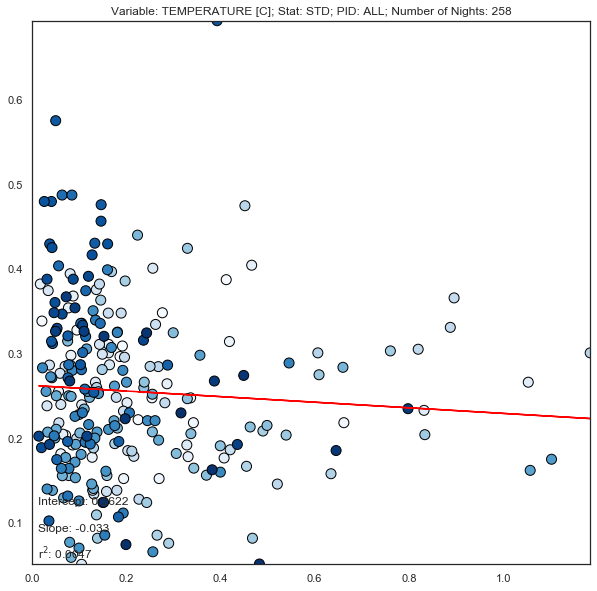

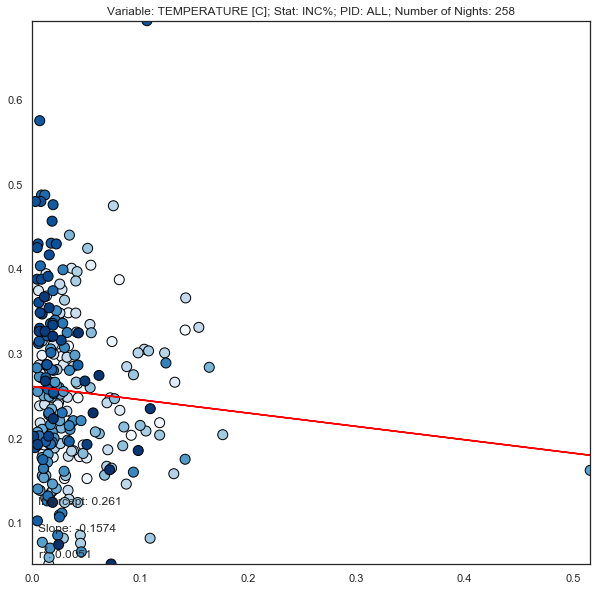

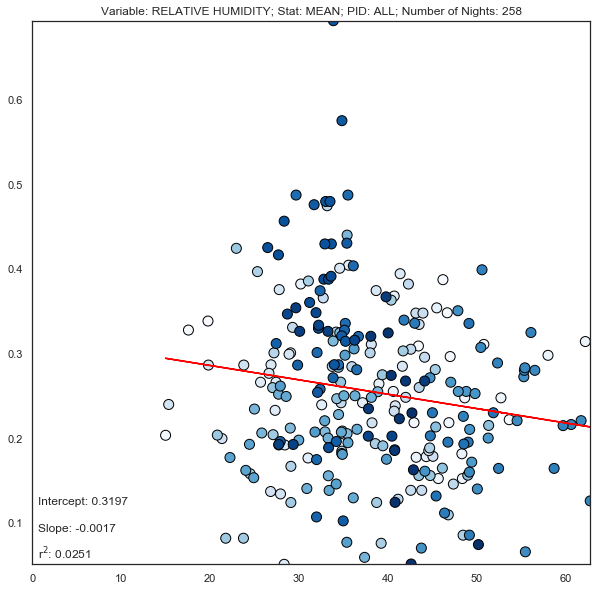

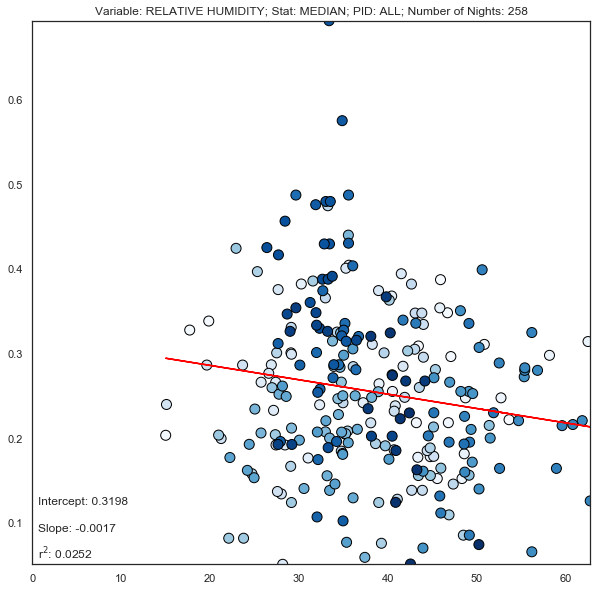

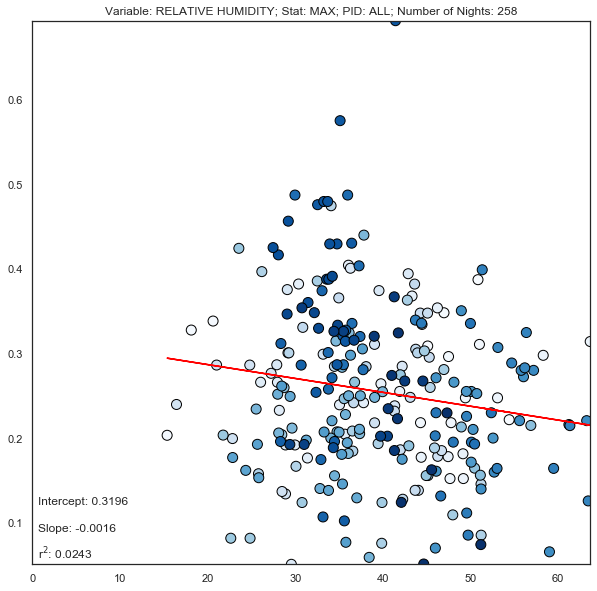

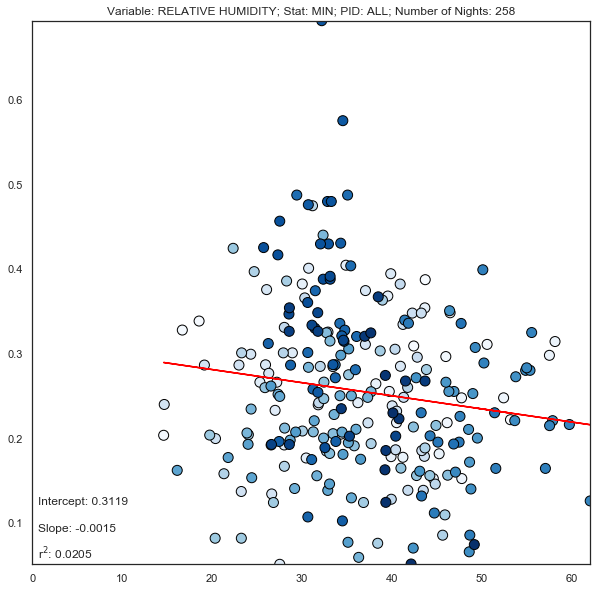

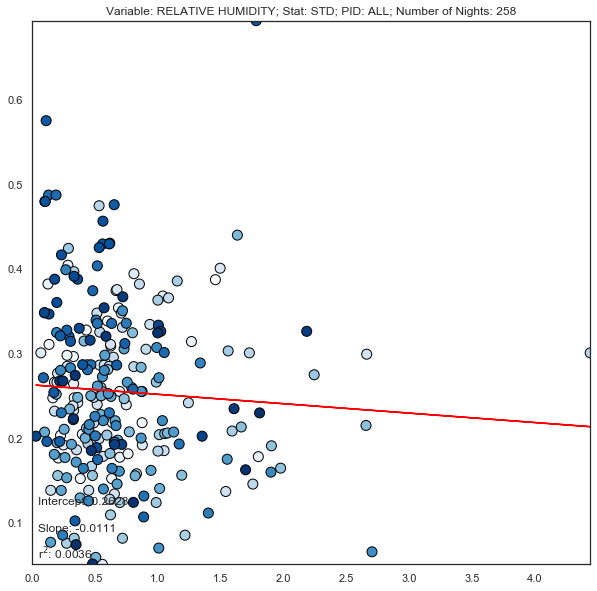

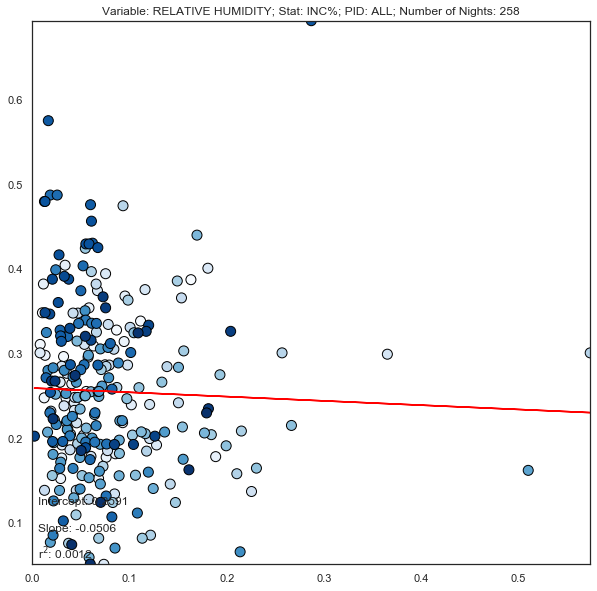

Limited data for participant z7trat1j


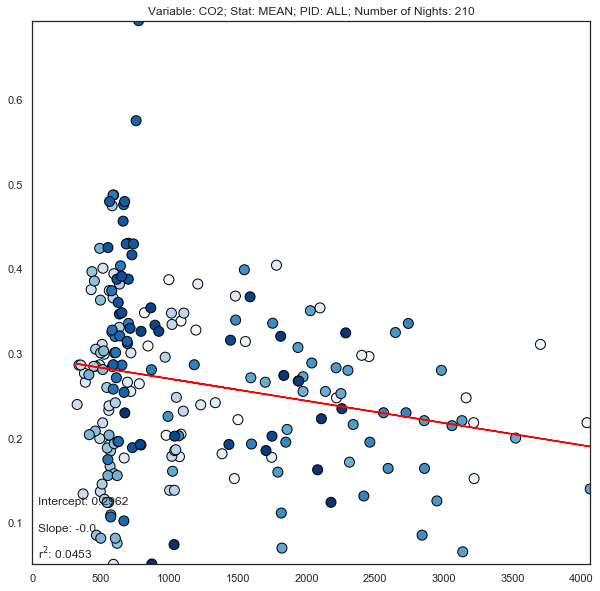

Limited data for participant z7trat1j


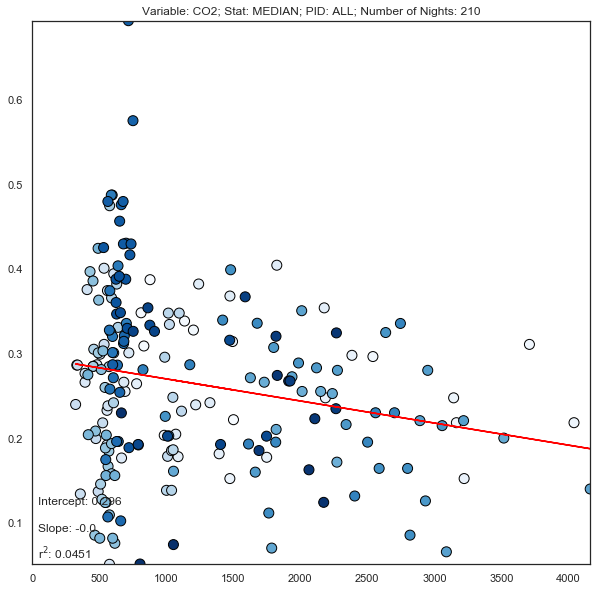

Limited data for participant z7trat1j


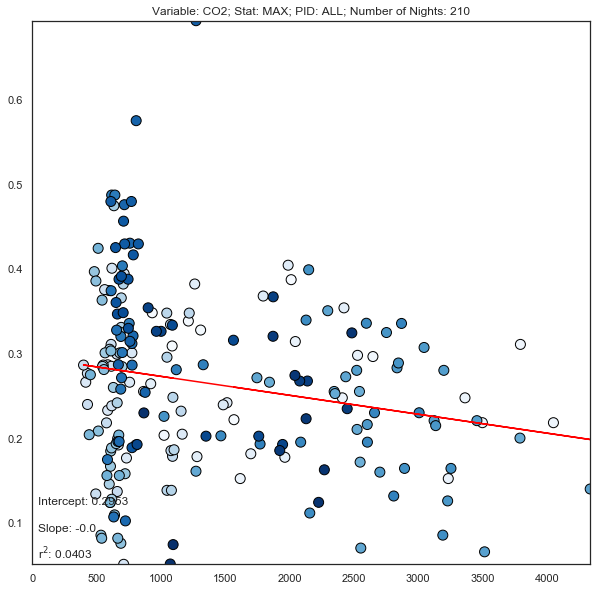

Limited data for participant z7trat1j


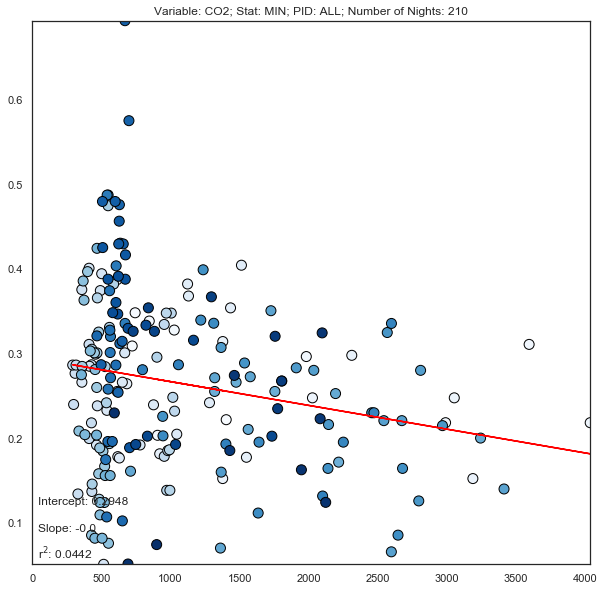

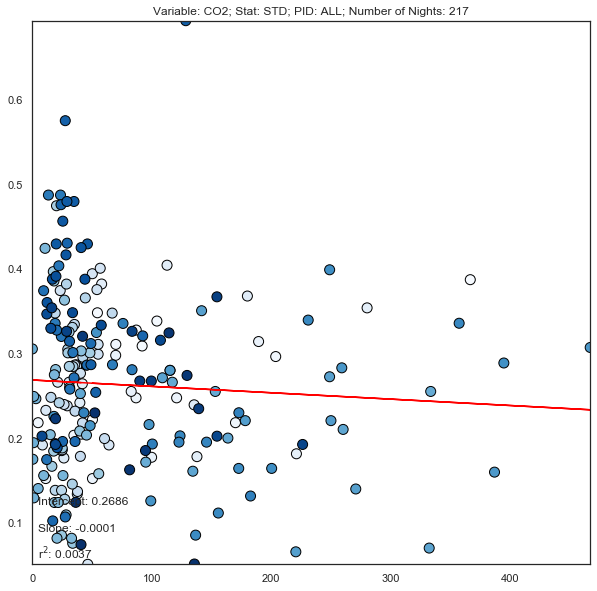

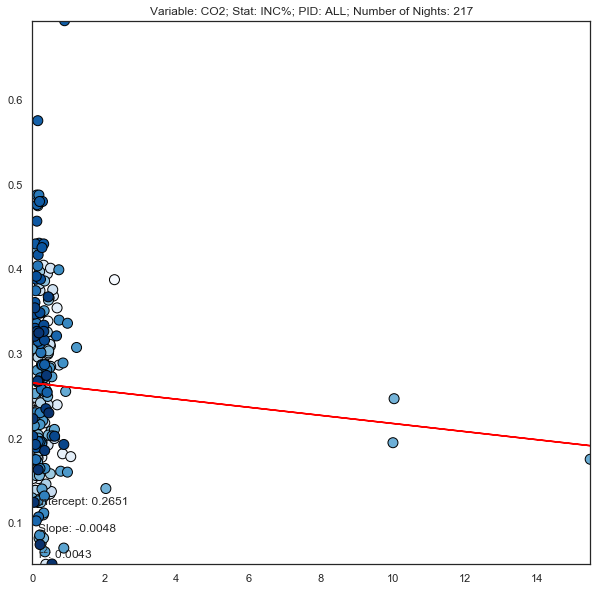

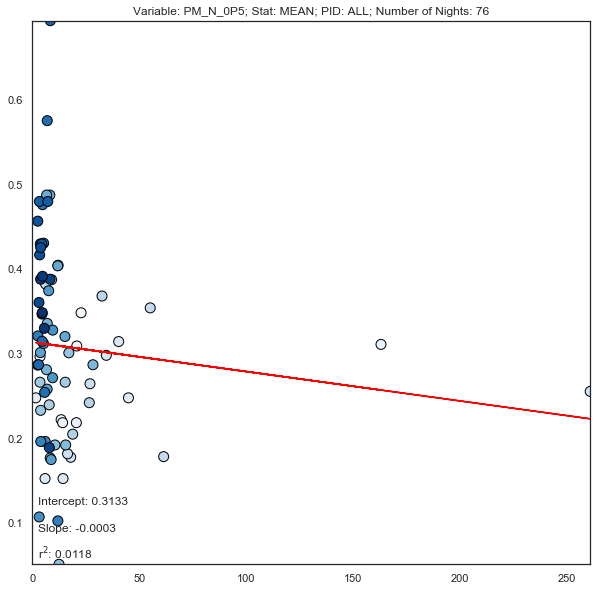

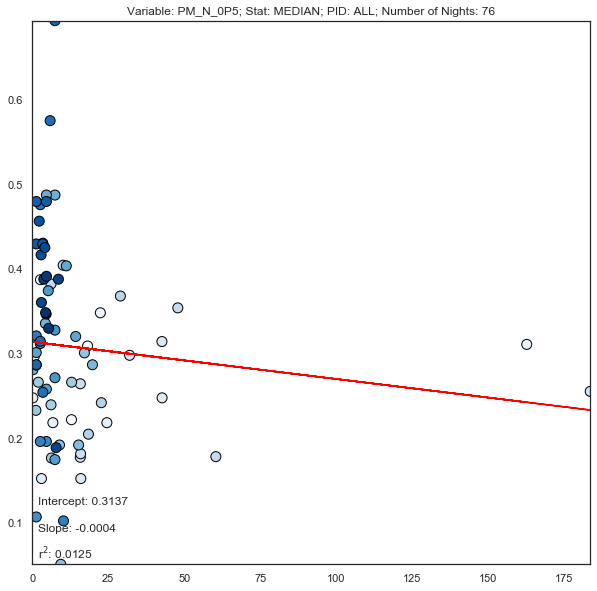

...

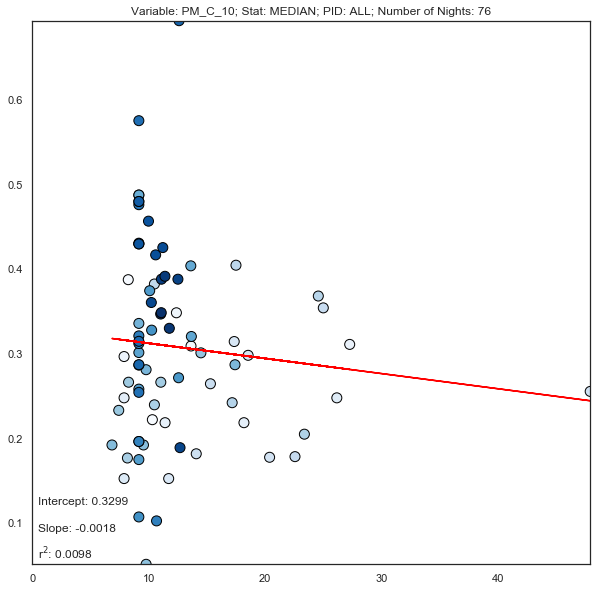

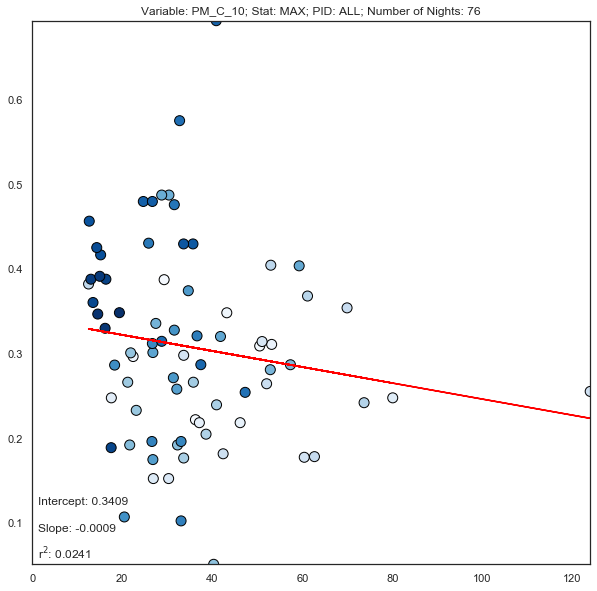

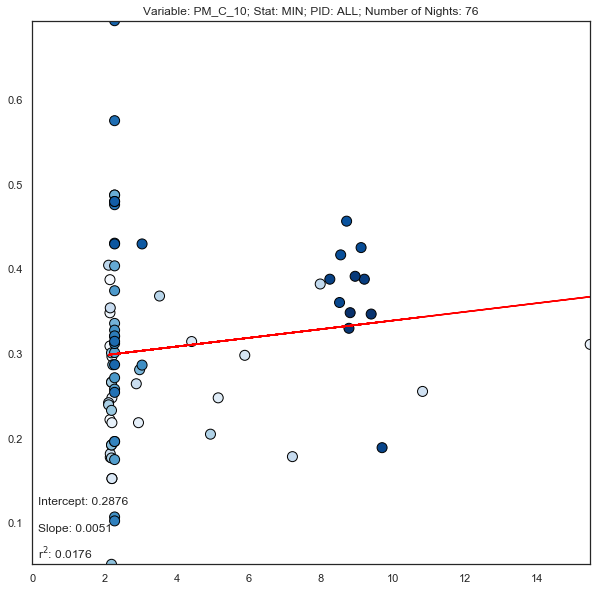

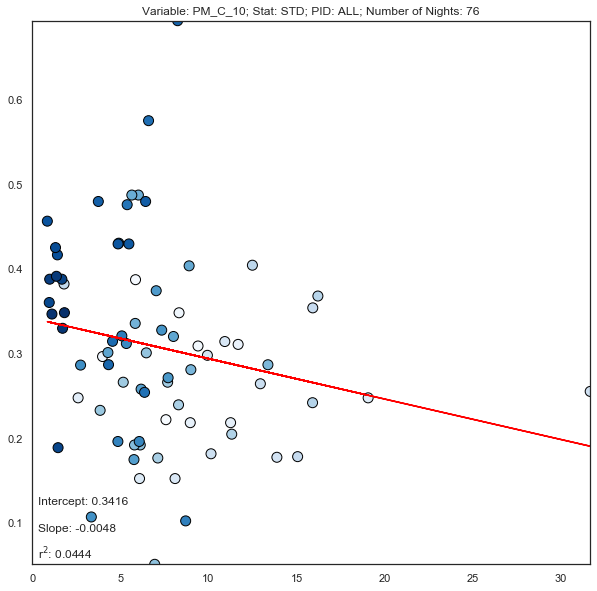

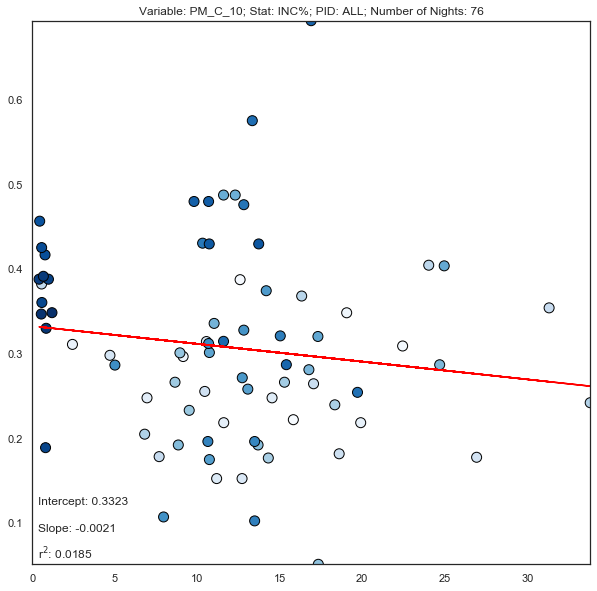

In [59]:
results_df = pd.DataFrame()
# Looping through each of the variables in py2
for var in df_py2['var'].unique():
    
    # Masking by variables - still has all participants
    df_py2_byvar = df_py2[df_py2['var'] == var]
    
    # Looping through all the statistics - skipping over the ID and var columns
    for column in df_py2_byvar.columns:
        if column in ['ID','var']:
            continue
        
        # Looping through all the participants
        overall = pd.DataFrame()
        for pid in df_py2_byvar['ID'].unique():
            dep_vars_ind = df_py2_byvar[df_py2_byvar['ID'] == pid]
            indep_vars_ind = df_ss[df_ss['ID'] == pid]
            combined = pd.concat([dep_vars_ind,indep_vars_ind],join='inner',axis=1)
            
            combined = combined[combined['REM/nREM'] > 0]
            
            if var == 'Temperature [C]' and column in ['mean','median','min','max']:
                combined = combined[combined[column] > 15]
                
            if var == 'CO2' and column in ['mean','median','min','max']:
                combined = combined[combined[column] > 100]
                
            X = combined[column].values
            y = combined['REM/nREM'].values

            if len(X) > 1:
                ax, model = plotLinearRegression(X,[0,500],y,[0.7,1],False)
                try:
                    ax.set_title(f'PID: {pid.upper()}; Number of Nights: {len(combined)}')
                    plt.show()
                    plt.close()
                except:
                    pass

                overall = pd.concat([overall,combined])
            else:
                print(f'Limited data for participant {pid}')

        X = overall[column].values
        y = overall['REM/nREM'].values

        ax, model = plotLinearRegression(X,[0,max(X)],y,[min(y),max(y)],True)
        try:
            ax.set_title(f'Variable: {var.upper()}; Stat: {column.upper()}; PID: ALL; Number of Nights: {len(overall)}')
            plt.show()
            plt.close()
        except:
            pass

        onevar_df = pd.DataFrame(data={'Variable':[var],'Stat':[column.upper()],'Outcome':['REM2nREM'.upper()],
                                      'x0':[model.params[0]],'x1':[model.params[1]],'No. Points':[len(overall)],'Fit':[model.rsquared]})

        results_df = pd.concat([results_df,onevar_df])

In [60]:
results_df

,Variable,Stat,Outcome,x0,x1,No. Points,Fit
0,Temperature [C],MEAN,REM2NREM,0.060820,0.007360,255,0.025234
0,Temperature [C],MEDIAN,REM2NREM,0.066635,0.007141,255,0.024114
0,Temperature [C],MAX,REM2NREM,0.046599,0.007769,255,0.025114
0,Temperature [C],MIN,REM2NREM,0.071505,0.007072,255,0.027379
0,Temperature [C],STD,REM2NREM,0.262175,-0.033002,258,0.004664
...,...,...,...,...,...,...,...
0,PM_C_10,MEDIAN,REM2NREM,0.329918,-0.001792,76,0.009833
0,PM_C_10,MAX,REM2NREM,0.340851,-0.000948,76,0.024053
0,PM_C_10,MIN,REM2NREM,0.287586,0.005128,76,0.017633
0,PM_C_10,STD,REM2NREM,0.341607,-0.004775,76,0.044387


#### Fitbit

Limited data for participant 9l7wmsc3
Limited data for participant ng31u6a6
Limited data for participant jj1do3qt
Limited data for participant qw7a5lo4
Limited data for participant 8spjm55e
Limited data for participant oaskvmar
Limited data for participant f2tdu9gn
Limited data for participant tn9t3u64
Limited data for participant q3xw8s3e
Limited data for participant f5xj78qv
Limited data for participant daneytpw
Limited data for participant 7rrs62s5
Limited data for participant 7373cjon
Limited data for participant lytcvu3h
Limited data for participant eu33lm3s
Limited data for participant n35hfrwn
Limited data for participant k31skfp1
Limited data for participant s839pdl8
Limited data for participant 79bhqg93
Limited data for participant 6kyw2uwk
Limited data for participant 286vqdjn
Limited data for participant q2butblj
Limited data for participant t2vl7lyj
Limited data for participant 6ftd5dn6
Limited data for participant z7trat1j
Limited data for participant uqf1xyc5
Limited data

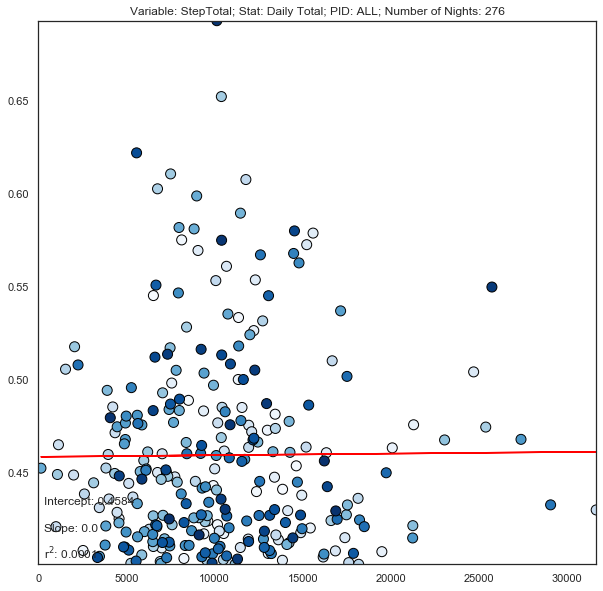

In [71]:
results_df = pd.DataFrame()

# Looping through all the participants
overall = pd.DataFrame()
for pid in df_steps['ID'].unique():
    dep_vars_ind = df_steps[df_steps['ID'] == pid]
    indep_vars_ind = df_ss[df_ss['ID'] == pid]
    combined = pd.concat([dep_vars_ind,indep_vars_ind],join='inner',axis=1)

    combined = combined[combined['REM/nREM'] > 0.4]

    X = combined['StepTotal'].values
    y = combined['REM/nREM'].values

    if len(X) > 1:
        ax, model = plotLinearRegression(X,[0,500],y,[0.7,1],False)
        try:
            ax.set_title(f'PID: {pid.upper()}; Number of Nights: {len(combined)}')
            plt.show()
            plt.close()
        except:
            pass

        overall = pd.concat([overall,combined])
    else:
        print(f'Limited data for participant {pid}')

X = overall['StepTotal'].values
y = overall['REM/nREM'].values

ax, model = plotLinearRegression(X,[0,max(X)],y,[min(y),max(y)],True)
try:
    ax.set_title(f'Variable: StepTotal; Stat: Daily Total; PID: ALL; Number of Nights: {len(overall)}')
    plt.show()
    plt.close()
except:
    pass

onevar_df = pd.DataFrame(data={'Variable':['StepTotal'],'Stat':['Total'],'Outcome':['REM2nREM'.upper()],
                              'x0':[model.params[0]],'x1':[model.params[1]],'No. Points':[len(overall)],'Fit':[model.rsquared]})

results_df = pd.concat([results_df,onevar_df])

In [69]:
results_df

,Variable,Stat,Outcome,x0,x1,No. Points,Fit
0,StepTotal,Total,SLEEP_EFFICIENCY,0.458417,8.617096e-08,276,0.000066


/Users/hagenfritz/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


exog contains inf or nans
Limited data for participant hrzjncys
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans


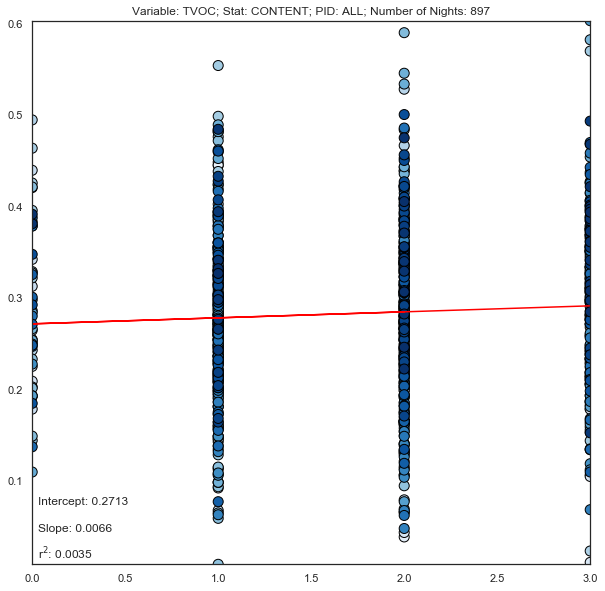

/Users/hagenfritz/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


exog contains inf or nans
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans


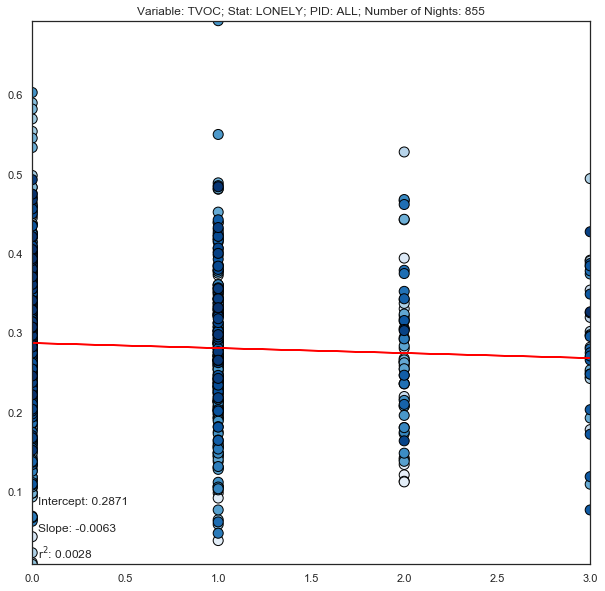

/Users/hagenfritz/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


exog contains inf or nans
exog contains inf or nans
exog contains inf or nans
Limited data for participant hrzjncys
exog contains inf or nans
exog contains inf or nans


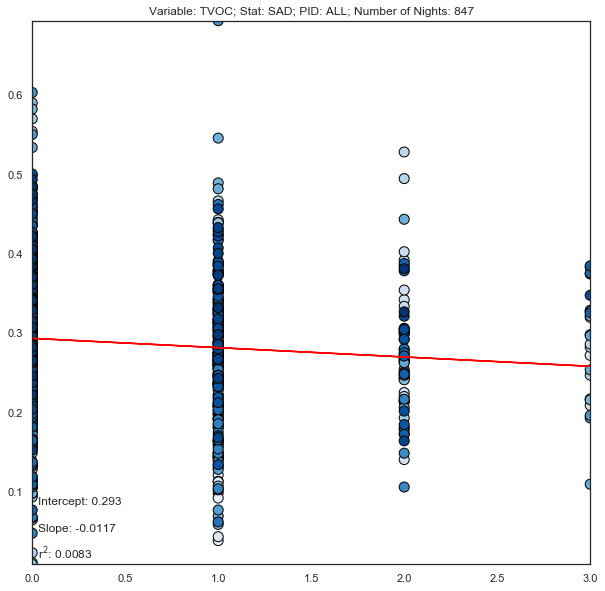

/Users/hagenfritz/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


exog contains inf or nans
exog contains inf or nans
Limited data for participant hrzjncys
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans


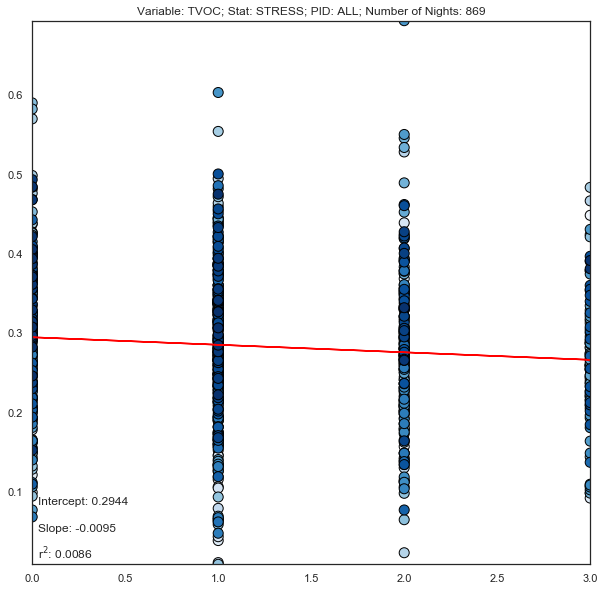

/Users/hagenfritz/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


exog contains inf or nans
exog contains inf or nans
Limited data for participant hrzjncys
exog contains inf or nans
exog contains inf or nans


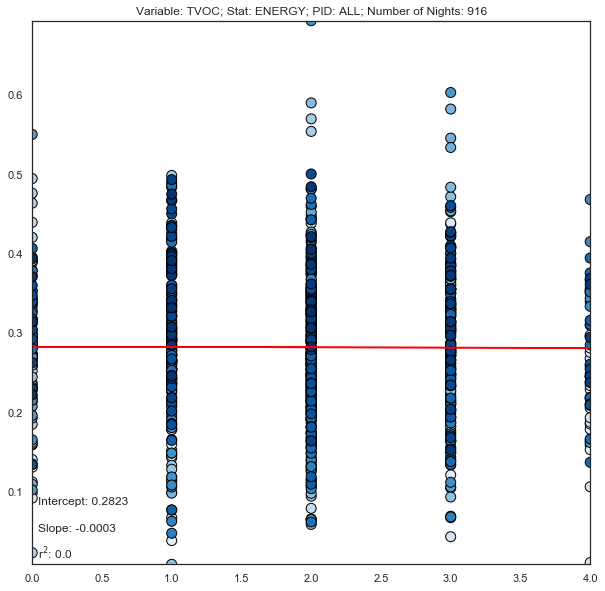

In [72]:
results_df = pd.DataFrame()
    
# Looping through all the moods - skipping over the ID and submitted columns
for column in df_evening.columns:
    if column in ['ID','Submitted','date']:
        continue

    # Looping through all the participants
    overall = pd.DataFrame()
    for pid in df_evening['ID'].unique():
        dep_vars_ind = df_evening[df_evening['ID'] == pid]
        dep_vars_ind['day'] = dep_vars_ind.index.date
        dep_vars_ind = dep_vars_ind.set_index('day')
        indep_vars_ind = df_ss[df_ss['ID'] == pid]
        combined = dep_vars_ind.merge(right=indep_vars_ind,how='inner',right_index=True,left_index=True)
        #combined = pd.concat([dep_vars_ind,indep_vars_ind],join='inner',axis=1)

        combined = combined[combined['REM/nREM'] > 0]

        X = combined[column].values
        y = combined['REM/nREM'].values
        
        if np.sum(X) == 0:
            continue
        
        if len(X) > 1:
            ax, model = plotLinearRegression(X,[0,4],y,[0.7,1],False)
            try:
                ax.set_title(f'PID: {pid.upper()}; Number of Nights: {len(combined)}')
                plt.show()
                plt.close()
            except:
                pass
            if model:
                overall = pd.concat([overall,combined])
        else:
            print(f'Limited data for participant {pid}')

    X = overall[column].values
    y = overall['REM/nREM'].values

    ax, model = plotLinearRegression(X,[0,max(X)],y,[min(y),max(y)],True)
    try:
        ax.set_title(f'Variable: {var.upper()}; Stat: {column.upper()}; PID: ALL; Number of Nights: {len(overall)}')
        plt.show()
        plt.close()
        
        onevar_df = pd.DataFrame(data={'Variable':[var],'Stat':[column.upper()],'Outcome':['sleep_efficiency'.upper()],
                                  'x0':[model.params[0]],'x1':[model.params[1]],'No. Points':[len(overall)],'Fit':[model.rsquared]})

        results_df = pd.concat([results_df,onevar_df])
    except:
        pass
    

In [76]:
results_df = pd.DataFrame()
# Looping through each of the variables in py3
for var in df_py3['var'].unique():
    if var in ['eCO2']:
        continue
    
    # Masking by variables - still has all participants
    df_py3_byvar = df_py3[df_py3['var'] == var]
    
    # Looping through all the statistics - skipping over the ID and var columns
    for column in df_py3_byvar.columns:
        if column in ['ID','var']:
            continue
        
        # Looping through all the participants
        overall = pd.DataFrame()
        for pid in df_py3_byvar['ID'].unique():
            dep_vars_ind = df_py3_byvar[df_py3_byvar['ID'] == pid]
            indep_vars_ind = df_ss[df_ss['ID'] == pid]
            combined = pd.concat([dep_vars_ind,indep_vars_ind],join='inner',axis=1)
            
            combined = combined[combined['Awake%'] > 0]

            if var in ['TVOC','Lux']:
                combined = combined[combined[column] > 5]
                
            X = combined[column].values
            y = combined['Awake%'].values

            if len(X) > 1:
                ax, model = plotLinearRegression(X,[0,500],y,[0.7,1],False)
                try:
                    ax.set_title(f'PID: {pid.upper()}; Number of Nights: {len(combined)}')
                    plt.show()
                    plt.close()
                except:
                    pass

                overall = pd.concat([overall,combined])
            else:
                print(f'Limited data for participant {pid}')

        X = overall[column].values
        y = overall['Awake%'].values

        ax, model = plotLinearRegression(X,[0,max(X)],y,[min(y),max(y)],False)
        try:
            ax.set_title(f'Variable: {var.upper()}; Stat: {column.upper()}; PID: ALL; Number of Nights: {len(overall)}')
            plt.show()
            plt.close()
        except:
            pass

        onevar_df = pd.DataFrame(data={'Variable':[var],'Stat':[column.upper()],'Outcome':['Awake'.upper()],
                                      'x0':[model.params[0]],'x1':[model.params[1]],'No. Points':[len(overall)],'Fit':[model.rsquared]})

        results_df = pd.concat([results_df,onevar_df])

Limited data for participant 332b3bxa
Limited data for participant vd2ajjap
Limited data for participant faz8lf76
Limited data for participant 7ri18iba
Limited data for participant o7g2lmna
Limited data for participant f2tdu9gn
Limited data for participant z7trat1j
Limited data for participant 6ftd5dn6
Limited data for participant ng31u6a6
Limited data for participant pho7eama
Limited data for participant daneytpw
Limited data for participant 332b3bxa
Limited data for participant vd2ajjap
Limited data for participant faz8lf76
Limited data for participant 7ri18iba
Limited data for participant o7g2lmna
Limited data for participant f2tdu9gn
Limited data for participant z7trat1j
Limited data for participant 6ftd5dn6
Limited data for participant ng31u6a6
Limited data for participant pho7eama
Limited data for participant hrzjncys
Limited data for participant 7v4s12kl
Limited data for participant daneytpw
Limited data for participant vd2ajjap
Limited data for participant faz8lf76
Limited data

In [77]:
results_df

,Variable,Stat,Outcome,x0,x1,No. Points,Fit
0,Lux,MEAN,AWAKE,0.115916,9.888584e-06,36,0.012545
0,Lux,MEDIAN,AWAKE,0.132122,2.240399e-05,5,0.110887
0,Lux,MAX,AWAKE,0.124796,-6.249162e-08,85,0.000036
0,Lux,MIN,AWAKE,0.211264,-1.752030e-03,2,1.000000
0,Lux,STD,AWAKE,0.121722,-6.151799e-07,46,0.000117
0,Lux,INC%,AWAKE,0.123746,-1.958458e-07,91,0.000083
0,Visible,MEAN,AWAKE,0.126592,-2.097527e-10,171,0.003641
0,Visible,MEDIAN,AWAKE,0.126467,-3.889776e-10,171,0.005149
0,Visible,MAX,AWAKE,0.126440,-1.129771e-11,171,0.001265
0,Visible,MIN,AWAKE,0.126322,-1.258588e-09,171,0.000360


Limited data for participant vd2ajjap


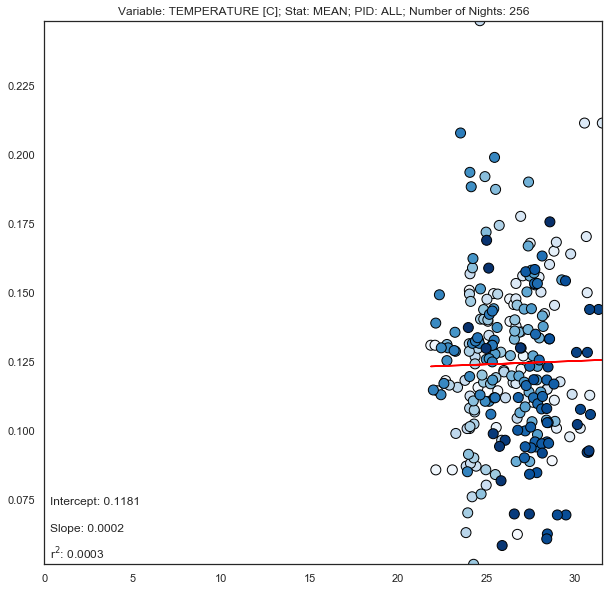

Limited data for participant vd2ajjap


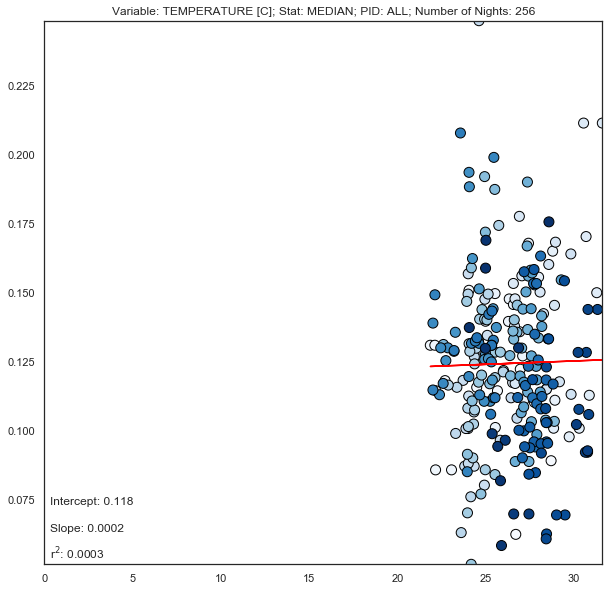

Limited data for participant vd2ajjap


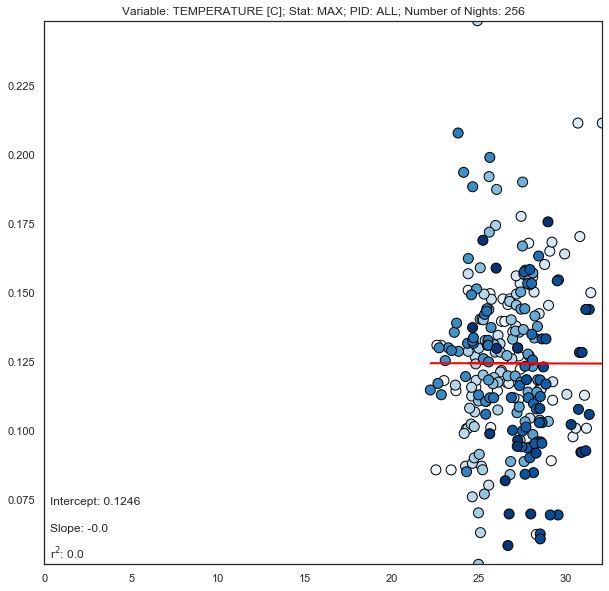

Limited data for participant vd2ajjap


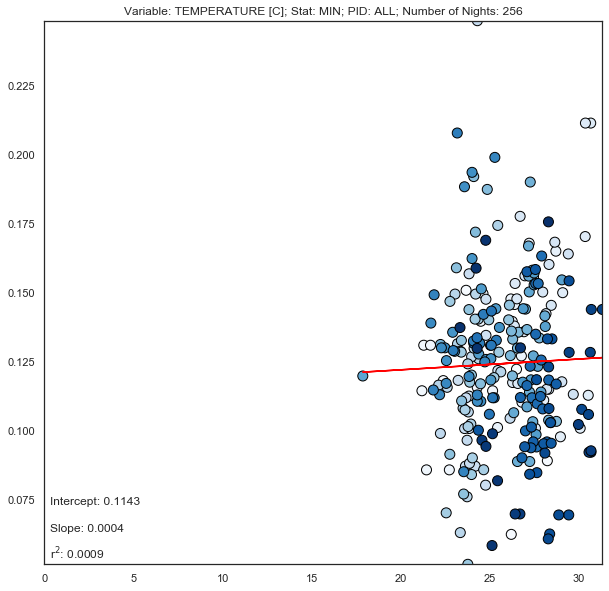

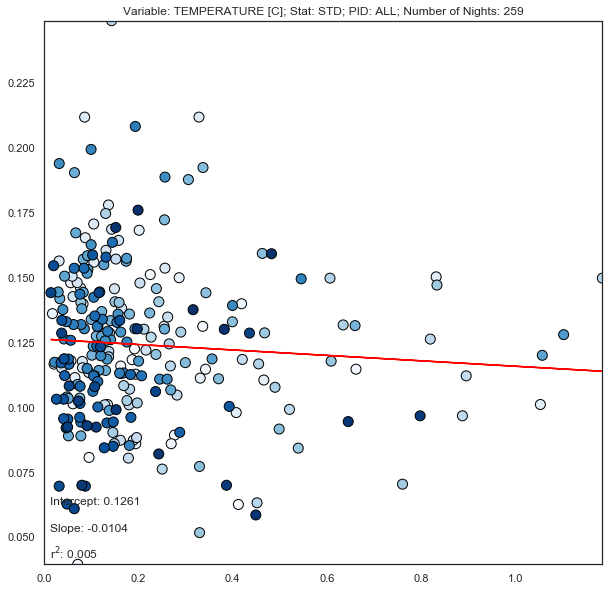

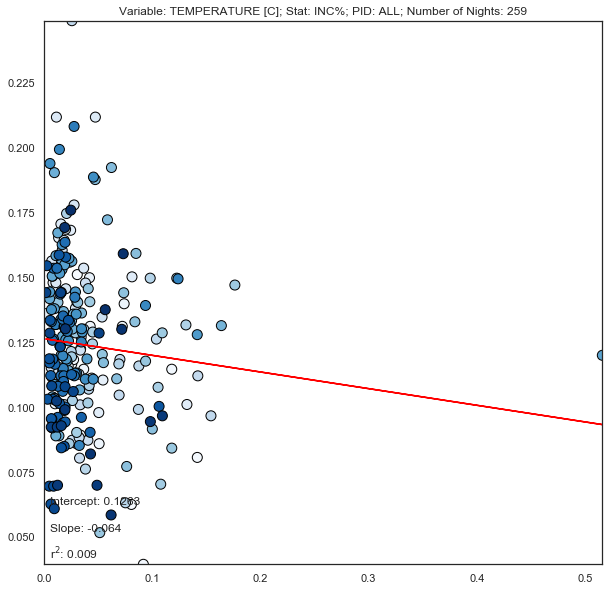

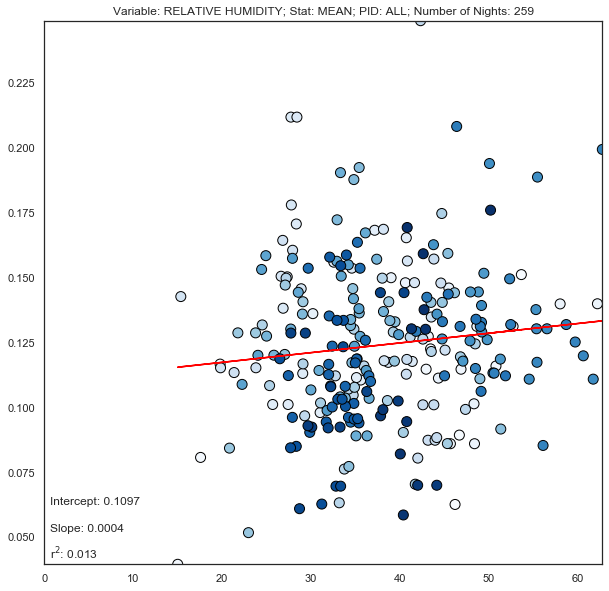

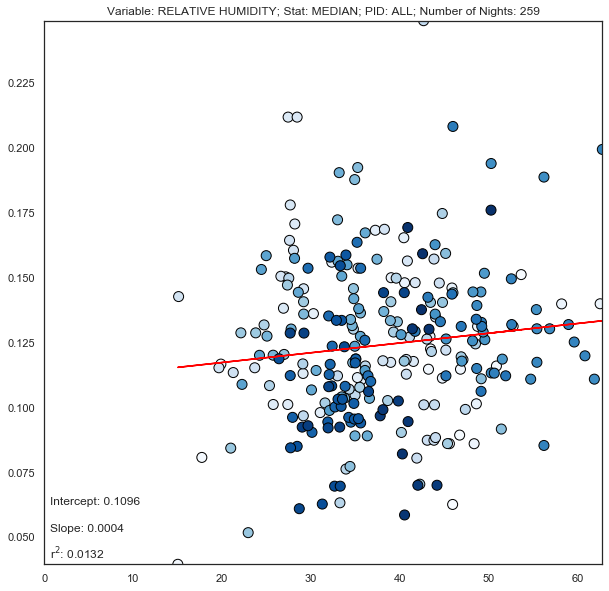

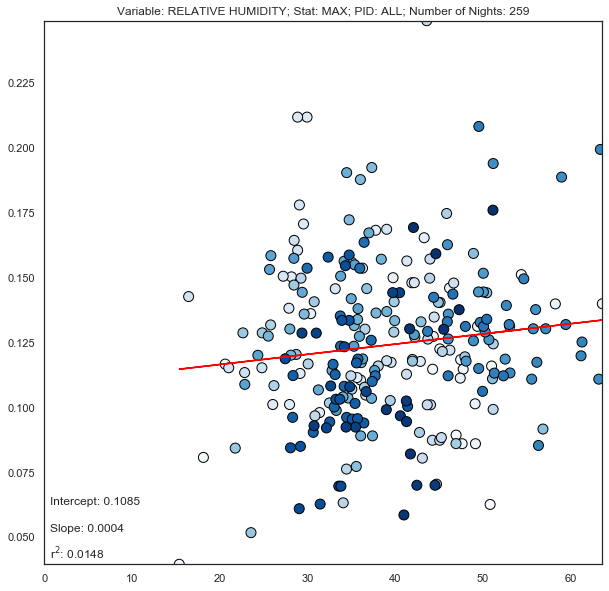

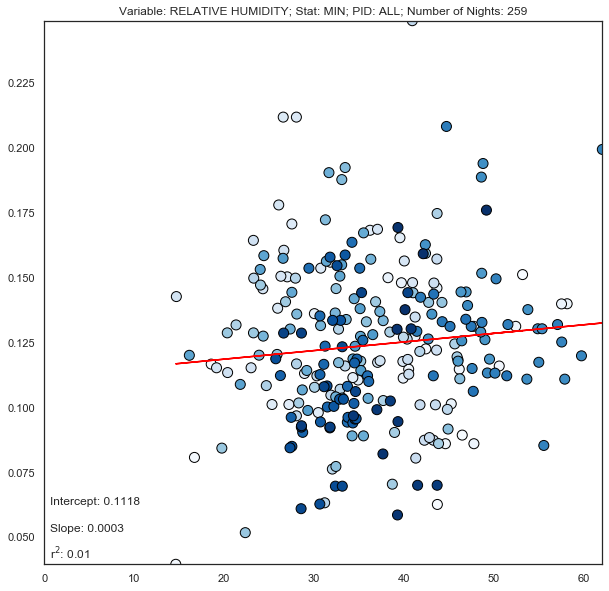

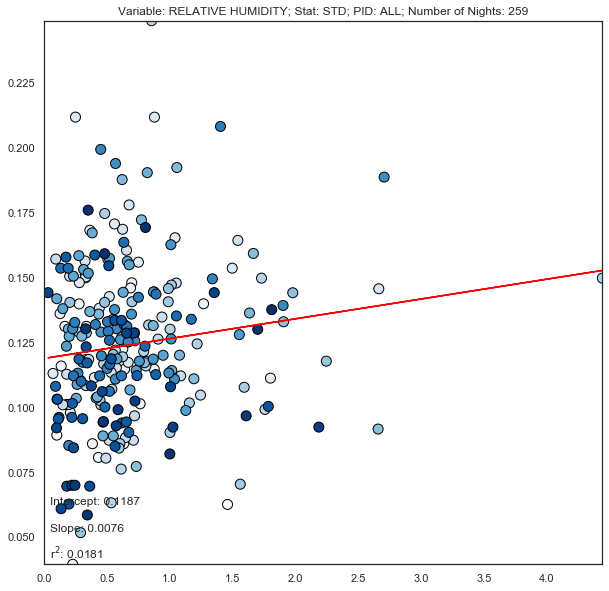

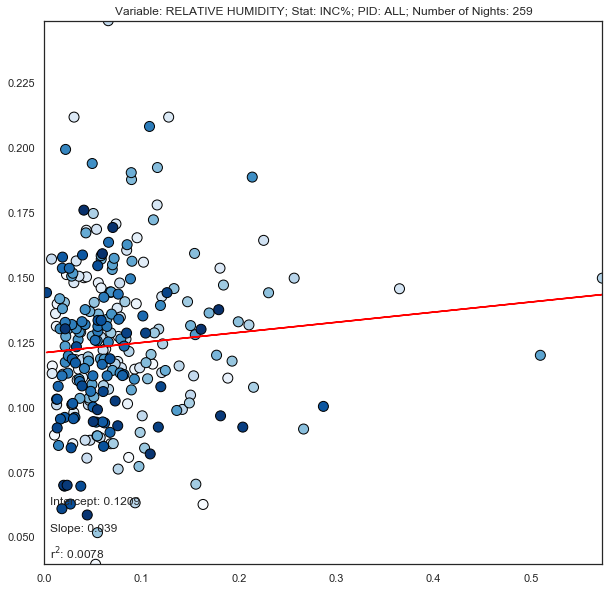

Limited data for participant z7trat1j


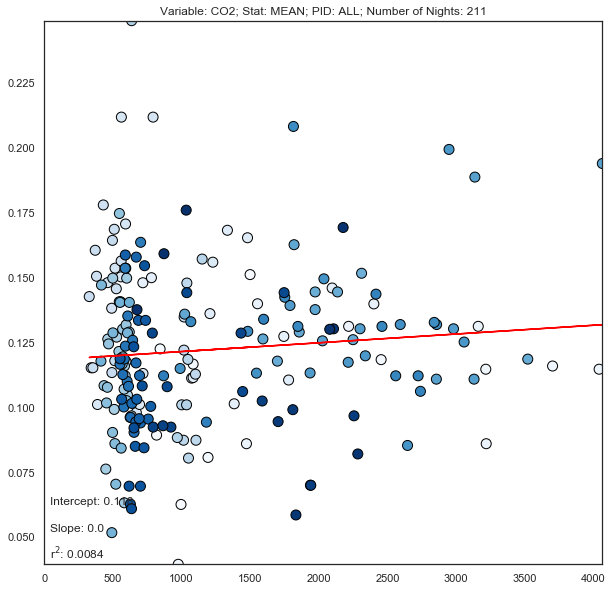

Limited data for participant z7trat1j


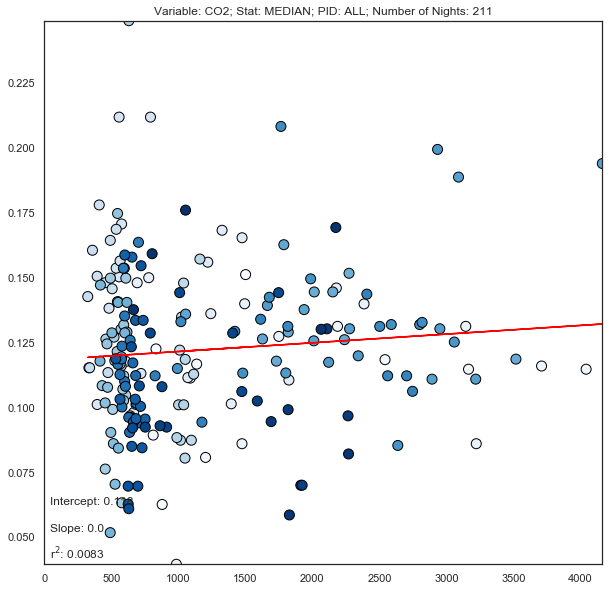

Limited data for participant z7trat1j


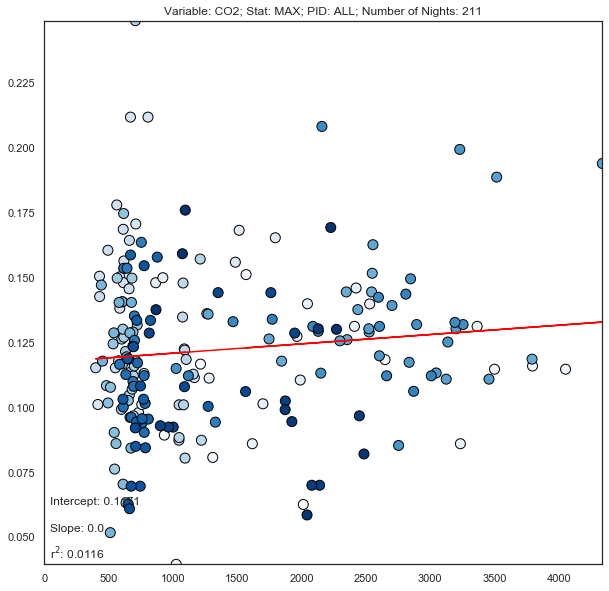

Limited data for participant z7trat1j


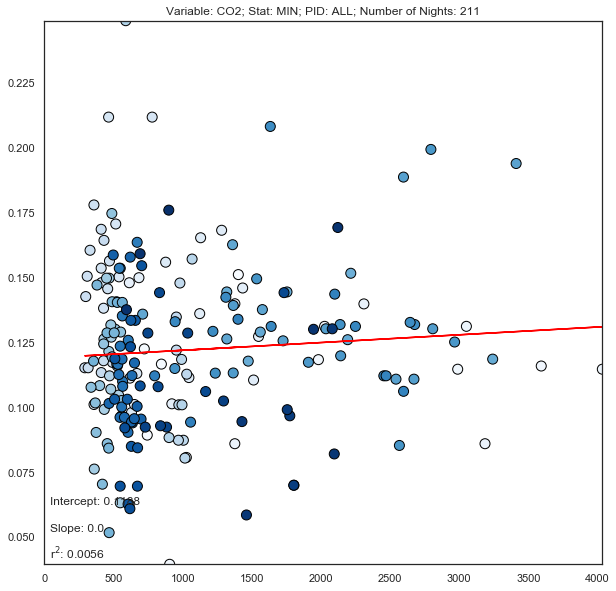

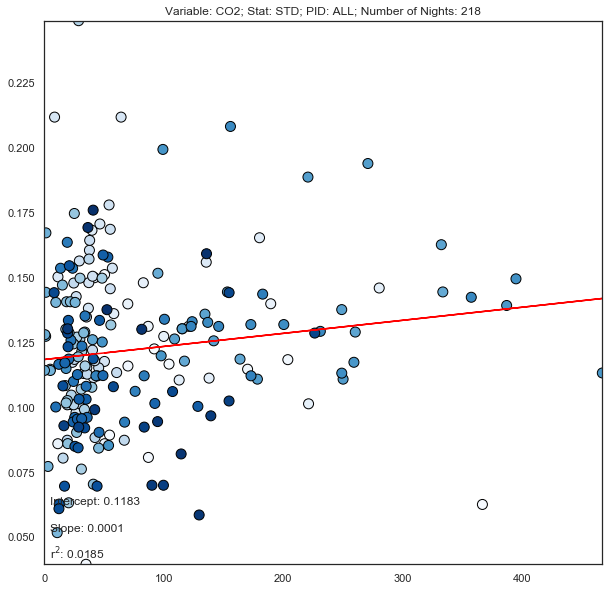

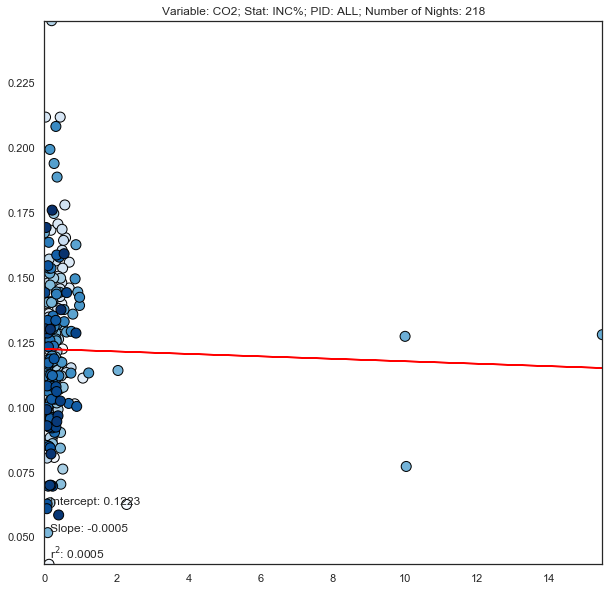

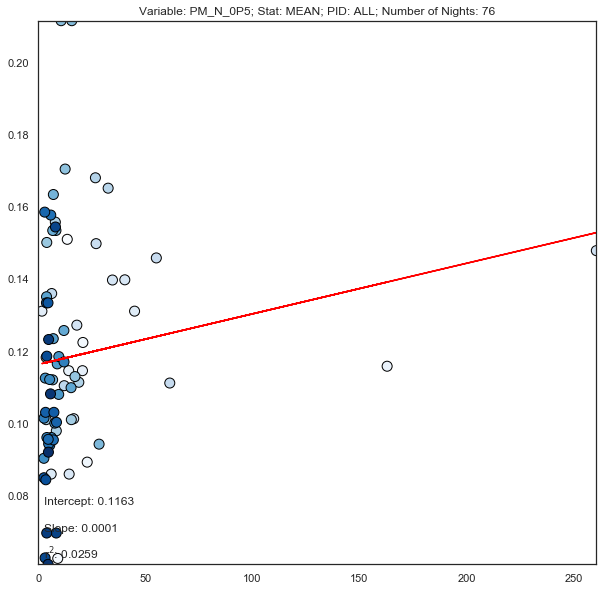

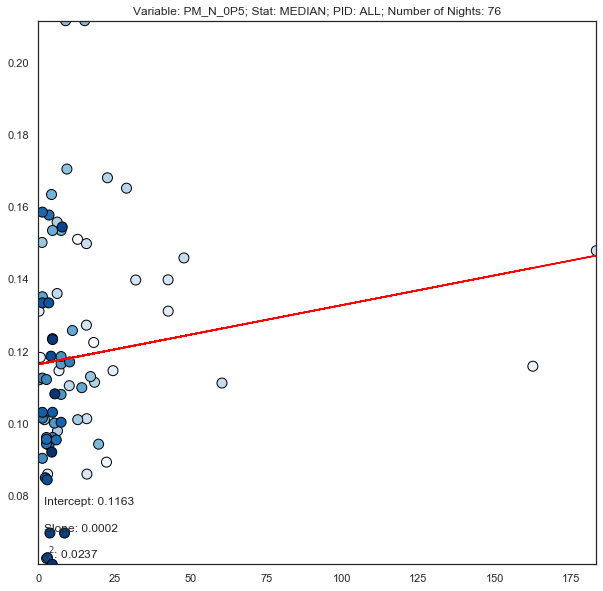

...

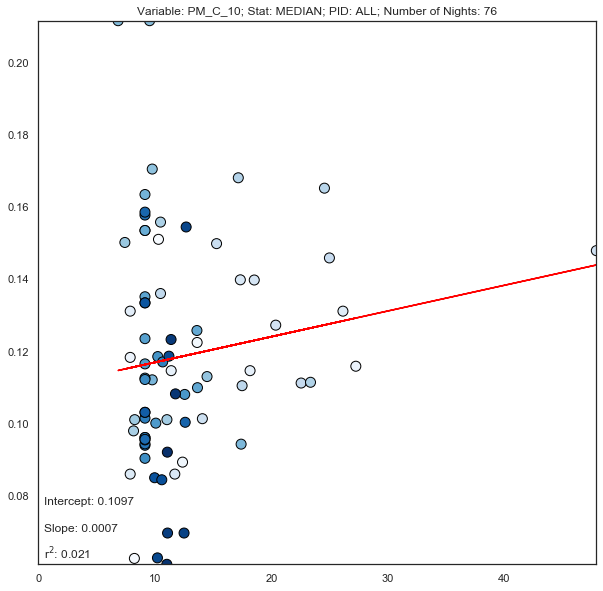

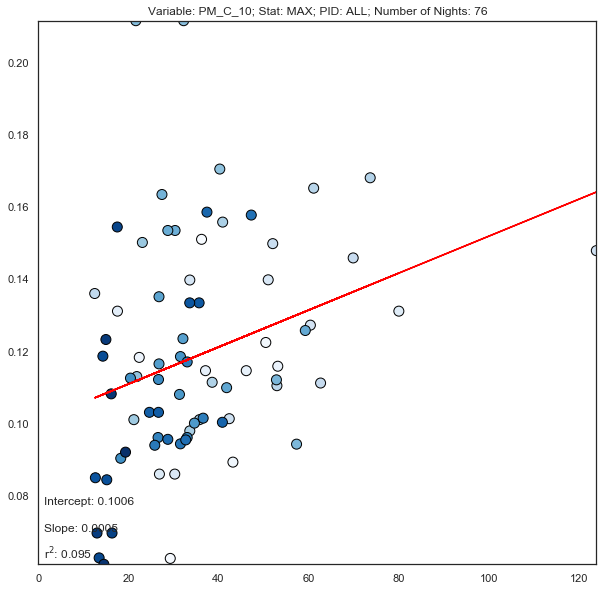

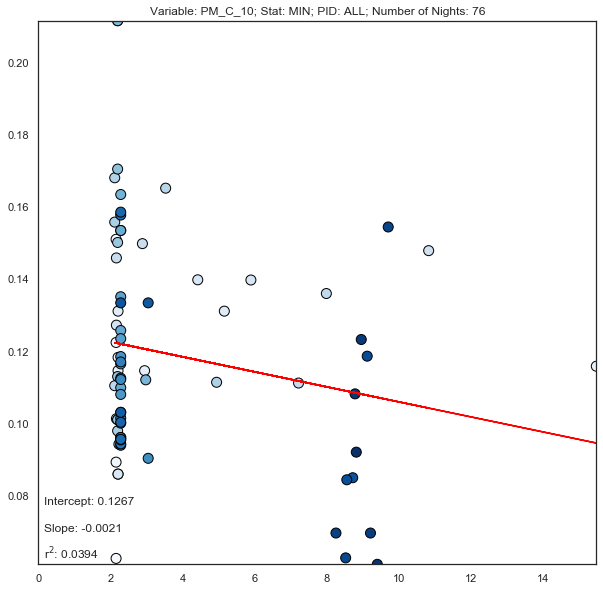

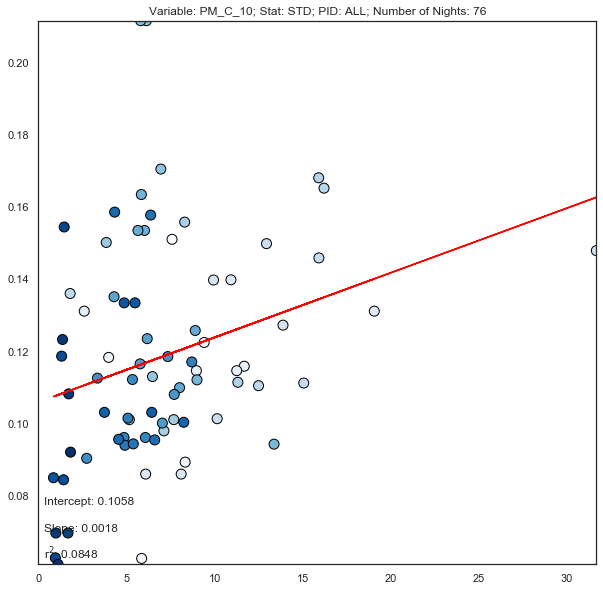

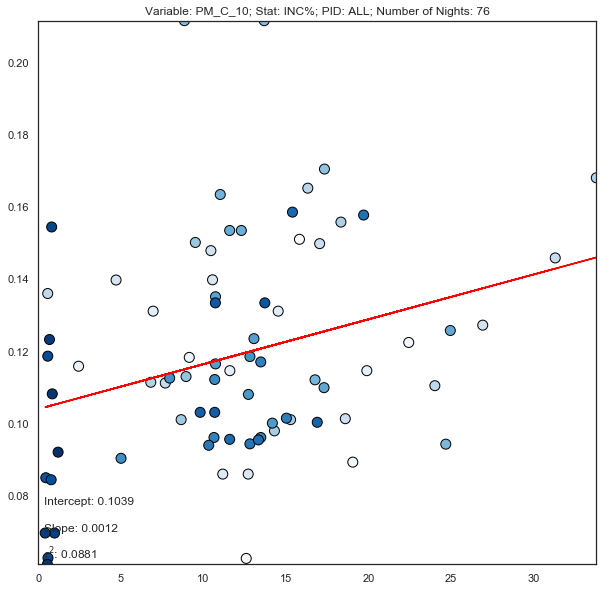

In [78]:
results_df = pd.DataFrame()
# Looping through each of the variables in py2
for var in df_py2['var'].unique():
    
    # Masking by variables - still has all participants
    df_py2_byvar = df_py2[df_py2['var'] == var]
    
    # Looping through all the statistics - skipping over the ID and var columns
    for column in df_py2_byvar.columns:
        if column in ['ID','var']:
            continue
        
        # Looping through all the participants
        overall = pd.DataFrame()
        for pid in df_py2_byvar['ID'].unique():
            dep_vars_ind = df_py2_byvar[df_py2_byvar['ID'] == pid]
            indep_vars_ind = df_ss[df_ss['ID'] == pid]
            combined = pd.concat([dep_vars_ind,indep_vars_ind],join='inner',axis=1)
            
            combined = combined[combined['Awake%'] > 0]
            
            if var == 'Temperature [C]' and column in ['mean','median','min','max']:
                combined = combined[combined[column] > 15]
                
            if var == 'CO2' and column in ['mean','median','min','max']:
                combined = combined[combined[column] > 100]
                
            X = combined[column].values
            y = combined['Awake%'].values

            if len(X) > 1:
                ax, model = plotLinearRegression(X,[0,500],y,[0.7,1],False)
                try:
                    ax.set_title(f'PID: {pid.upper()}; Number of Nights: {len(combined)}')
                    plt.show()
                    plt.close()
                except:
                    pass

                overall = pd.concat([overall,combined])
            else:
                print(f'Limited data for participant {pid}')

        X = overall[column].values
        y = overall['Awake%'].values

        ax, model = plotLinearRegression(X,[0,max(X)],y,[min(y),max(y)],True)
        try:
            ax.set_title(f'Variable: {var.upper()}; Stat: {column.upper()}; PID: ALL; Number of Nights: {len(overall)}')
            plt.show()
            plt.close()
        except:
            pass

        onevar_df = pd.DataFrame(data={'Variable':[var],'Stat':[column.upper()],'Outcome':['Awake'.upper()],
                                      'x0':[model.params[0]],'x1':[model.params[1]],'No. Points':[len(overall)],'Fit':[model.rsquared]})

        results_df = pd.concat([results_df,onevar_df])

In [79]:
results_df

,Variable,Stat,Outcome,x0,x1,No. Points,Fit
0,Temperature [C],MEAN,REM2NREM,0.118062,0.000242,256,3.029442e-04
0,Temperature [C],MEDIAN,REM2NREM,0.118029,0.000243,256,3.108897e-04
0,Temperature [C],MAX,REM2NREM,0.124632,-0.000007,256,2.359610e-07
0,Temperature [C],MIN,REM2NREM,0.114301,0.000391,256,9.289757e-04
0,Temperature [C],STD,REM2NREM,0.126116,-0.010432,259,4.979967e-03
...,...,...,...,...,...,...,...
0,PM_C_10,MEDIAN,REM2NREM,0.109711,0.000712,76,2.104916e-02
0,PM_C_10,MAX,REM2NREM,0.100586,0.000512,76,9.503038e-02
0,PM_C_10,MIN,REM2NREM,0.126711,-0.002084,76,3.944754e-02
0,PM_C_10,STD,REM2NREM,0.105822,0.001792,76,8.475713e-02


Limited data for participant 6kyw2uwk
Limited data for participant nan


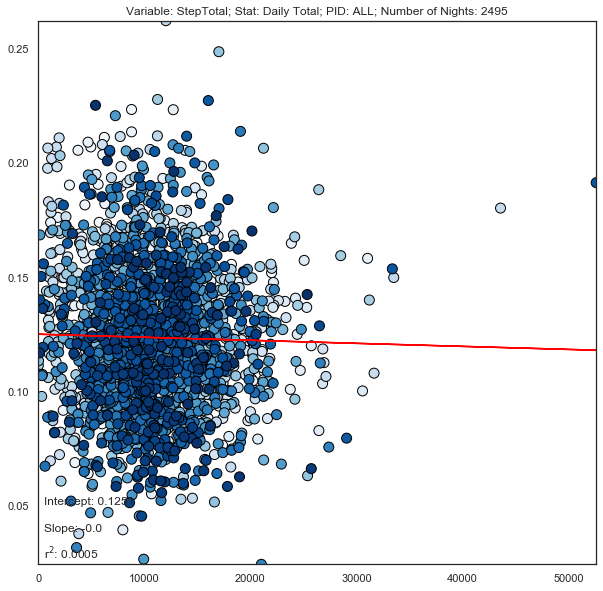

In [85]:
results_df = pd.DataFrame()

# Looping through all the participants
overall = pd.DataFrame()
for pid in df_steps['ID'].unique():
    dep_vars_ind = df_steps[df_steps['ID'] == pid]
    indep_vars_ind = df_ss[df_ss['ID'] == pid]
    combined = pd.concat([dep_vars_ind,indep_vars_ind],join='inner',axis=1)

    combined = combined[combined['Awake%'] > 0]

    X = combined['StepTotal'].values
    y = combined['Awake%'].values

    if len(X) > 1:
        ax, model = plotLinearRegression(X,[0,500],y,[0.7,1],False)
        try:
            ax.set_title(f'PID: {pid.upper()}; Number of Nights: {len(combined)}')
            plt.show()
            plt.close()
        except:
            pass

        overall = pd.concat([overall,combined])
    else:
        print(f'Limited data for participant {pid}')

X = overall['StepTotal'].values
y = overall['Awake%'].values

ax, model = plotLinearRegression(X,[0,max(X)],y,[min(y),max(y)],True)
try:
    ax.set_title(f'Variable: StepTotal; Stat: Daily Total; PID: ALL; Number of Nights: {len(overall)}')
    plt.show()
    plt.close()
except:
    pass

onevar_df = pd.DataFrame(data={'Variable':['StepTotal'],'Stat':['Total'],'Outcome':['Awake'.upper()],
                              'x0':[model.params[0]],'x1':[model.params[1]],'No. Points':[len(overall)],'Fit':[model.rsquared]})

results_df = pd.concat([results_df,onevar_df])

In [86]:
results_df

,Variable,Stat,Outcome,x0,x1,No. Points,Fit
0,StepTotal,Total,AWAKE,0.12505,-1.330215e-07,2495,0.000476


/Users/hagenfritz/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


exog contains inf or nans
Limited data for participant hrzjncys
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans


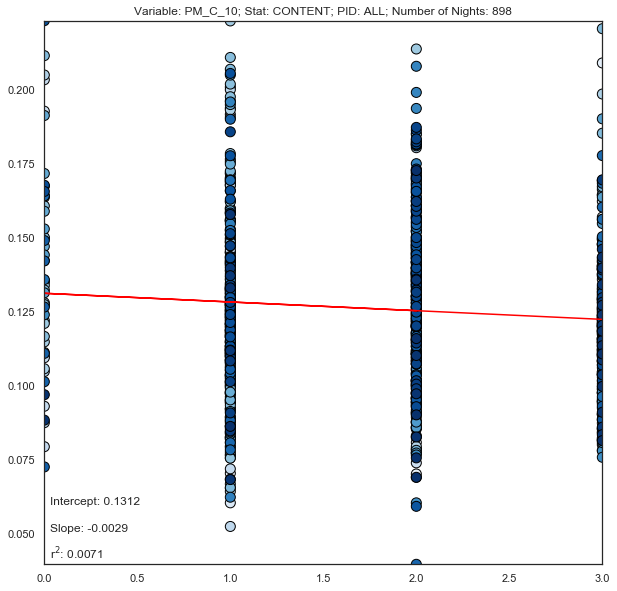

/Users/hagenfritz/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


exog contains inf or nans
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans


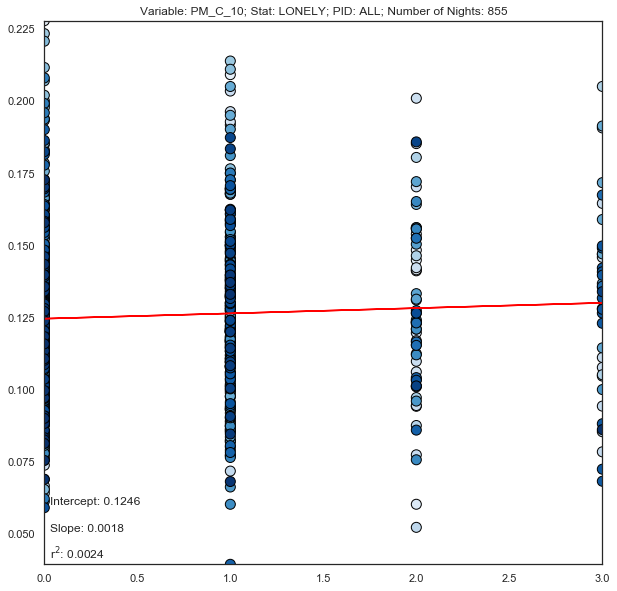

/Users/hagenfritz/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


exog contains inf or nans
exog contains inf or nans
exog contains inf or nans
Limited data for participant hrzjncys
exog contains inf or nans
exog contains inf or nans


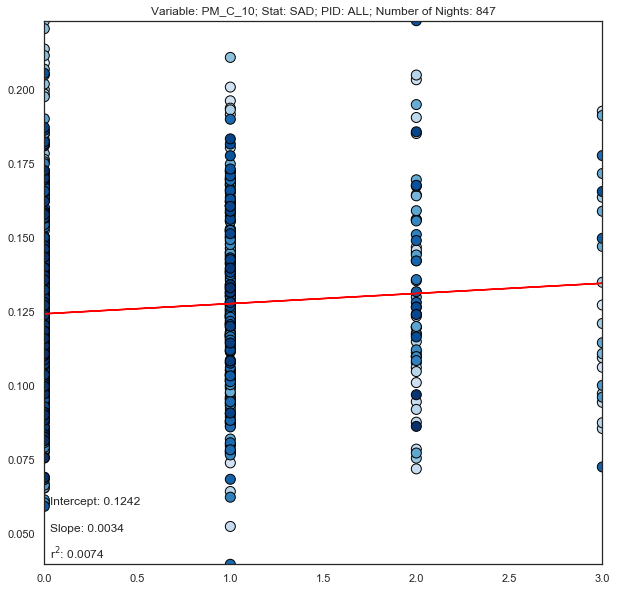

/Users/hagenfritz/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


exog contains inf or nans
exog contains inf or nans
Limited data for participant hrzjncys
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans
exog contains inf or nans


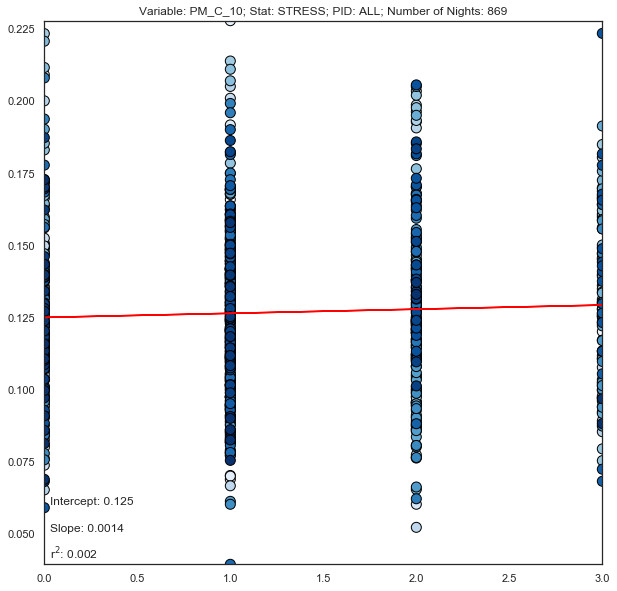

/Users/hagenfritz/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


exog contains inf or nans
exog contains inf or nans
Limited data for participant hrzjncys
exog contains inf or nans
exog contains inf or nans


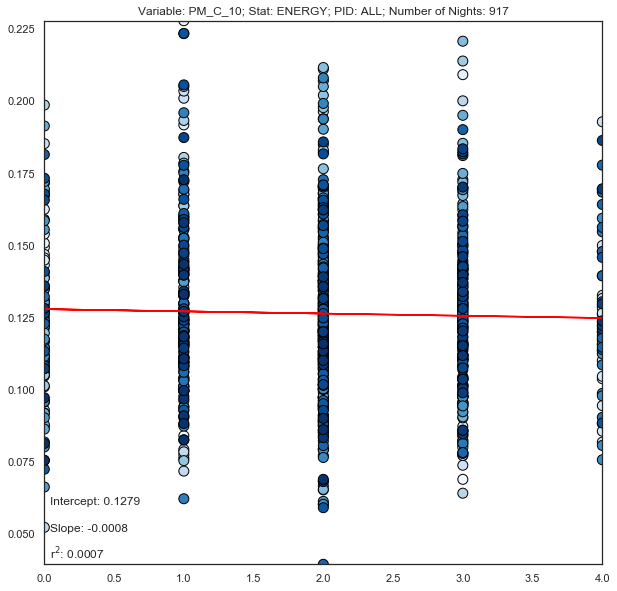

In [82]:
results_df = pd.DataFrame()
    
# Looping through all the moods - skipping over the ID and submitted columns
for column in df_evening.columns:
    if column in ['ID','Submitted','date']:
        continue

    # Looping through all the participants
    overall = pd.DataFrame()
    for pid in df_evening['ID'].unique():
        dep_vars_ind = df_evening[df_evening['ID'] == pid]
        dep_vars_ind['day'] = dep_vars_ind.index.date
        dep_vars_ind = dep_vars_ind.set_index('day')
        indep_vars_ind = df_ss[df_ss['ID'] == pid]
        combined = dep_vars_ind.merge(right=indep_vars_ind,how='inner',right_index=True,left_index=True)
        #combined = pd.concat([dep_vars_ind,indep_vars_ind],join='inner',axis=1)

        combined = combined[combined['Awake%'] > 0]

        X = combined[column].values
        y = combined['Awake%'].values
        
        if np.sum(X) == 0:
            continue
        
        if len(X) > 1:
            ax, model = plotLinearRegression(X,[0,4],y,[0.7,1],False)
            try:
                ax.set_title(f'PID: {pid.upper()}; Number of Nights: {len(combined)}')
                plt.show()
                plt.close()
            except:
                pass
            if model:
                overall = pd.concat([overall,combined])
        else:
            print(f'Limited data for participant {pid}')

    X = overall[column].values
    y = overall['Awake%'].values

    ax, model = plotLinearRegression(X,[0,max(X)],y,[min(y),max(y)],True)
    try:
        ax.set_title(f'Variable: {var.upper()}; Stat: {column.upper()}; PID: ALL; Number of Nights: {len(overall)}')
        plt.show()
        plt.close()
        
        onevar_df = pd.DataFrame(data={'Variable':[var],'Stat':[column.upper()],'Outcome':['sleep_efficiency'.upper()],
                                  'x0':[model.params[0]],'x1':[model.params[1]],'No. Points':[len(overall)],'Fit':[model.rsquared]})

        results_df = pd.concat([results_df,onevar_df])
    except:
        pass
    

In [83]:
results_df

,Variable,Stat,Outcome,x0,x1,No. Points,Fit
0,PM_C_10,CONTENT,SLEEP_EFFICIENCY,0.131151,-0.002941,898,0.007092
0,PM_C_10,LONELY,SLEEP_EFFICIENCY,0.124555,0.001823,855,0.002442
0,PM_C_10,SAD,SLEEP_EFFICIENCY,0.124220,0.003438,847,0.007354
0,PM_C_10,STRESS,SLEEP_EFFICIENCY,0.124982,0.001427,869,0.001999
0,PM_C_10,ENERGY,SLEEP_EFFICIENCY,0.127854,-0.000764,917,0.000735
